In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(
    { "figure.figsize": (6, 4) },
    style='ticks',
    color_codes=True,
    font_scale=0.8
)
%config InlineBackend.figure_formats = set(('retina', 'svg'))
import warnings
warnings.filterwarnings("ignore")

In [2]:
#load the data
fr_heart = pd.read_csv('C:/Users/DELL/Desktop/MSC PROJECT/framingham.csv')

In [3]:
#check sample data
fr_heart.head(3)

,Unnamed: 0,RANDID,SEX,TOTCHOL,AGE,SYSBP,DIABP,CURSMOKE,CIGPDAY,BMI,...,CVD,HYPERTEN,TIMEAP,TIMEMI,TIMEMIFC,TIMECHD,TIMESTRK,TIMECVD,TIMEDTH,TIMEHYP
0,1,2448,1,195.0,39,106.0,70.0,0,0.0,26.97,...,1,0,8766,6438,6438,6438,8766,6438,8766,8766
1,2,2448,1,209.0,52,121.0,66.0,0,0.0,NaN,...,1,0,8766,6438,6438,6438,8766,6438,8766,8766
2,3,6238,2,250.0,46,121.0,81.0,0,0.0,28.73,...,0,0,8766,8766,8766,8766,8766,8766,8766,8766


In [4]:
#check data info
fr_heart.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11627 entries, 0 to 11626
Data columns (total 40 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  11627 non-null  int64  
 1   RANDID      11627 non-null  int64  
 2   SEX         11627 non-null  int64  
 3   TOTCHOL     11218 non-null  float64
 4   AGE         11627 non-null  int64  
 5   SYSBP       11627 non-null  float64
 6   DIABP       11627 non-null  float64
 7   CURSMOKE    11627 non-null  int64  
 8   CIGPDAY     11548 non-null  float64
 9   BMI         11575 non-null  float64
 10  DIABETES    11627 non-null  int64  
 11  BPMEDS      11034 non-null  float64
 12  HEARTRTE    11621 non-null  float64
 13  GLUCOSE     10187 non-null  float64
 14  educ        11332 non-null  float64
 15  PREVCHD     11627 non-null  int64  
 16  PREVAP      11627 non-null  int64  
 17  PREVMI      11627 non-null  int64  
 18  PREVSTRK    11627 non-null  int64  
 19  PREVHYP     11627 non-nul

+ The dataset comprises 11,627 observations with 40 features. Among these features, 29 are of integer type (**int64**), and 11 are of floating-point type (**float64**).   


**Quick Observations**  
1. Features with substantial missing values such as HDLC and LDLC will be removed. These observations are only available for period three.    

2. The features TIMEAP, TIMEMI, TIMEMIFC, TIMECHD, TIMESTRK, TIMECVD, TIMEDTH, TIMEHYP represent the time to the occurrence of specific events. These are derived from the outcome variables and will be removed as the interest in this research is to predict the events themselves, not the time to their occurrence.  

3. Randid, TIME, PERIOD and Unnamed features will be removed as they have no predictive value in a model  

4. ANGINA, HOSPMI, MI_FCHD, DEATH, ANYCHD represent specific types of events. So, I will be removing these features since the interest is to predict a broader outcome (CVD).



This quick observations set the basis for reducing the features to achieve our desired outcome. Other features could be removed later after EDA.


In [5]:
#check for duplicates

duplicate_rows = fr_heart[fr_heart.duplicated()]

if duplicate_rows.empty:
    print("No duplicate rows found.")
else:
    print("Duplicate rows found:")
    print(duplicate_rows)


No duplicate rows found.


In [6]:
# List of features to remove
features_to_remove = ['ANGINA', 'HOSPMI', 'MI_FCHD', 'DEATH', 'TIMEAP', 'TIMEMI', 'TIMEMIFC', 'TIMECHD','TIMESTRK','TIMECVD', 'TIMEDTH', 'TIMEHYP', 'HDLC','LDLC', 'Unnamed: 0', 'RANDID' ]

# Remove the specified features from the DataFrame
fr_heart = fr_heart.drop(features_to_remove, axis=1)
fr_heart.head(3)

,SEX,TOTCHOL,AGE,SYSBP,DIABP,CURSMOKE,CIGPDAY,BMI,DIABETES,BPMEDS,...,PREVAP,PREVMI,PREVSTRK,PREVHYP,TIME,PERIOD,ANYCHD,STROKE,CVD,HYPERTEN
0,1,195.0,39,106.0,70.0,0,0.0,26.97,0,0.0,...,0,0,0,0,0,1,1,0,1,0
1,1,209.0,52,121.0,66.0,0,0.0,NaN,0,0.0,...,0,0,0,0,4628,3,1,0,1,0
2,2,250.0,46,121.0,81.0,0,0.0,28.73,0,0.0,...,0,0,0,0,0,1,0,0,0,0


In [7]:
fr_heart.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'SYSBP', 'DIABP', 'CURSMOKE', 'CIGPDAY', 'BMI',
       'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'educ', 'PREVCHD',
       'PREVAP', 'PREVMI', 'PREVSTRK', 'PREVHYP', 'TIME', 'PERIOD', 'ANYCHD',
       'STROKE', 'CVD', 'HYPERTEN'],
      dtype='object')

In [8]:
fr_heart['ANYCHD'].value_counts()

ANYCHD
0    8469
1    3158
Name: count, dtype: int64

In [9]:
fr_heart['CVD'].value_counts()

CVD
0    8728
1    2899
Name: count, dtype: int64

In [10]:

# Create a new column 'CVD' that is 1 if any of the specified conditions are 1, otherwise 0
fr_heart['CHD'] = (fr_heart[['ANYCHD', 'CVD']].max(axis=1) > 0).astype(int)

# Display the DataFrame to verify the new 'PRE_EVENTS' column
print(fr_heart[['ANYCHD', 'CVD','CHD']].head())  # showing only the first few rows for brevity


   ANYCHD  CVD  CHD
0       1    1    1
1       1    1    1
2       0    0    0
3       0    0    0
4       0    0    0


In [11]:
fr_heart['CHD'].value_counts()

CHD
0    7865
1    3762
Name: count, dtype: int64

In [12]:
#Lets check for missing values and the percentage in relation to the data
missing_values_count = pd.DataFrame({'Missing Values':fr_heart.isna().sum()})
total = len(fr_heart)
percentage_missing_values = round((missing_values_count['Missing Values']/total)*100,1)
missing_values_count['Percentage'] = percentage_missing_values
missing_values_count.sort_values(by='Missing Values',ascending = False)

,Missing Values,Percentage
GLUCOSE,1440,12.4
BPMEDS,593,5.1
TOTCHOL,409,3.5
educ,295,2.5
CIGPDAY,79,0.7
BMI,52,0.4
HEARTRTE,6,0.1
PREVSTRK,0,0.0
HYPERTEN,0,0.0
CVD,0,0.0


We can observe that we have missing values in the following features:  
**Glucose: 12.4\%  
Bpmeds: 5.1\%    
Totchol: 3.5\%   
Educ: 2.5\%  
Cigpday: 0.7\%    
Bmi: 0.4\%  
Heartrte: 0.1\%**    

Before going ahead to find the distribution between the variables, let us fill the missing values.


**Filling Missing Values**  

There are many techniques to fill missing value. Usually, we can use mean, median and mode imputation techniques. There are also methods like bfill and ffill.   

HEARTRTE, BMI, and CIGPDAY missing values are less than 1\%, so I will be filling the missing values using ffill because the overall impact on the dataset's integrity is minimal. Forward filling ensures that these missing values are replaced without significantly altering the distribution or patterns in the data.  

Educ feature missing values will be filled using mode imputation because it is a categorical variable. Mode imputation is suitable here because it preserves the most common category and the missing percentage is relatively low.   

TOTCHOL is a continuous variable, and with only 3.5% missing, mean or median imputation is appropriate.

BPMeds is a categorical variable indicating whether an individual is on anti hypentensive medication. Given the categorical nature and the missing percentage, imputing using the mode (the most frequent category) is a simple and effective method. 

GLUCOSE levels are typically continuous and can vary significantly among individuals based on various factors (e.g., diet, diabetes status). Since 12.4% is a relatively high proportion of missing data, KNN imputation would be more appropriate than simple methods like mean or median imputation.KNN imputes missing values based on the nearest neighbors' values in the feature space, preserving the natural variability in glucose levels.  


In [13]:
#filling missing values using ffill

# Apply forward fill to the specified columns
fr_heart[['HEARTRTE', 'BMI', 'CIGPDAY']] = fr_heart[['HEARTRTE', 'BMI', 'CIGPDAY']].ffill()

# Verify that the missing values have been filled
print(fr_heart[['HEARTRTE', 'BMI', 'CIGPDAY']].isnull().sum())


HEARTRTE    0
BMI         0
CIGPDAY     0
dtype: int64


In [14]:
# Fill missing values in 'educ' with the mode
fr_heart['educ'] = fr_heart['educ'].fillna(fr_heart['educ'].mode()[0])

# Verify that the missing values have been filled
print(fr_heart['educ'].isnull().sum())


0


In [15]:
#filling the TOTCHOL missing values using median
fr_heart['TOTCHOL'].fillna(fr_heart['TOTCHOL'].median(), inplace=True)
print(fr_heart['TOTCHOL'].isnull().sum())


0


In [16]:
# Fill missing values in 'educ' with the mode
fr_heart['BPMEDS'] = fr_heart['BPMEDS'].fillna(fr_heart['BPMEDS'].mode()[0])

# Verify that the missing values have been filled
print(fr_heart['BPMEDS'].isnull().sum())


0


In [17]:
# KNN Imputation for Glucose
from sklearn.impute import KNNImputer

knn_imputer = KNNImputer(n_neighbors=5)
fr_heart['GLUCOSE'] = knn_imputer.fit_transform(fr_heart[['GLUCOSE']])
print(fr_heart['GLUCOSE'].isnull().sum())


0


In [18]:
#Now, lets check if we have any missing value left

fr_heart.isnull().sum()

SEX         0
TOTCHOL     0
AGE         0
SYSBP       0
DIABP       0
CURSMOKE    0
CIGPDAY     0
BMI         0
DIABETES    0
BPMEDS      0
HEARTRTE    0
GLUCOSE     0
educ        0
PREVCHD     0
PREVAP      0
PREVMI      0
PREVSTRK    0
PREVHYP     0
TIME        0
PERIOD      0
ANYCHD      0
STROKE      0
CVD         0
HYPERTEN    0
CHD         0
dtype: int64

**PROJECT OBJECTIVES**  

Now, we can start addressing the objectives of our research study one after the other. For emphasis sake, here is our research objectives:  

1. Explore the relationship between predictor variables (such as age, gender, cholesterol levels, and blood pressure) and the presence or severity of heart disease.
2. Estimate the impact of each predictor variable on the likelihood of developing heart disease using odds ratios.
3. Identify the most influential risk factors associated with heart disease.
4. Develop suitable models using Python programming that can accurately predict the presence of heart disease.
5. Assess the goodness-of-fit of the GLM models and evaluate the overall performance

**EDA**    

To achieve the first objective, we will:

- Examine the features through Univariate, Bivariate, and Multivariate Analysis.
- Review descriptive statistics to gain insights into the distribution of each feature.
- Analyze the Target attribute visually to determine if the dataset is imbalanced.

In [19]:
# List of features to remove
features_to_remove = ['ANYCHD', 'CVD', 'TIME', 'PERIOD', 'educ']

# Remove the specified features from the DataFrame
fr_heart = fr_heart.drop(features_to_remove, axis=1)
fr_heart.head(3)

,SEX,TOTCHOL,AGE,SYSBP,DIABP,CURSMOKE,CIGPDAY,BMI,DIABETES,BPMEDS,HEARTRTE,GLUCOSE,PREVCHD,PREVAP,PREVMI,PREVSTRK,PREVHYP,STROKE,HYPERTEN,CHD
0,1,195.0,39,106.0,70.0,0,0.0,26.97,0,0.0,80.0,77.0,0,0,0,0,0,0,0,1
1,1,209.0,52,121.0,66.0,0,0.0,26.97,0,0.0,69.0,92.0,0,0,0,0,0,0,0,1
2,2,250.0,46,121.0,81.0,0,0.0,28.73,0,0.0,95.0,76.0,0,0,0,0,0,0,0,0


In [20]:
fr_heart.rename(columns={
    'CHD': 'CVD'
    
}, inplace=True)

fr_heart.head(3)

,SEX,TOTCHOL,AGE,SYSBP,DIABP,CURSMOKE,CIGPDAY,BMI,DIABETES,BPMEDS,HEARTRTE,GLUCOSE,PREVCHD,PREVAP,PREVMI,PREVSTRK,PREVHYP,STROKE,HYPERTEN,CVD
0,1,195.0,39,106.0,70.0,0,0.0,26.97,0,0.0,80.0,77.0,0,0,0,0,0,0,0,1
1,1,209.0,52,121.0,66.0,0,0.0,26.97,0,0.0,69.0,92.0,0,0,0,0,0,0,0,1
2,2,250.0,46,121.0,81.0,0,0.0,28.73,0,0.0,95.0,76.0,0,0,0,0,0,0,0,0


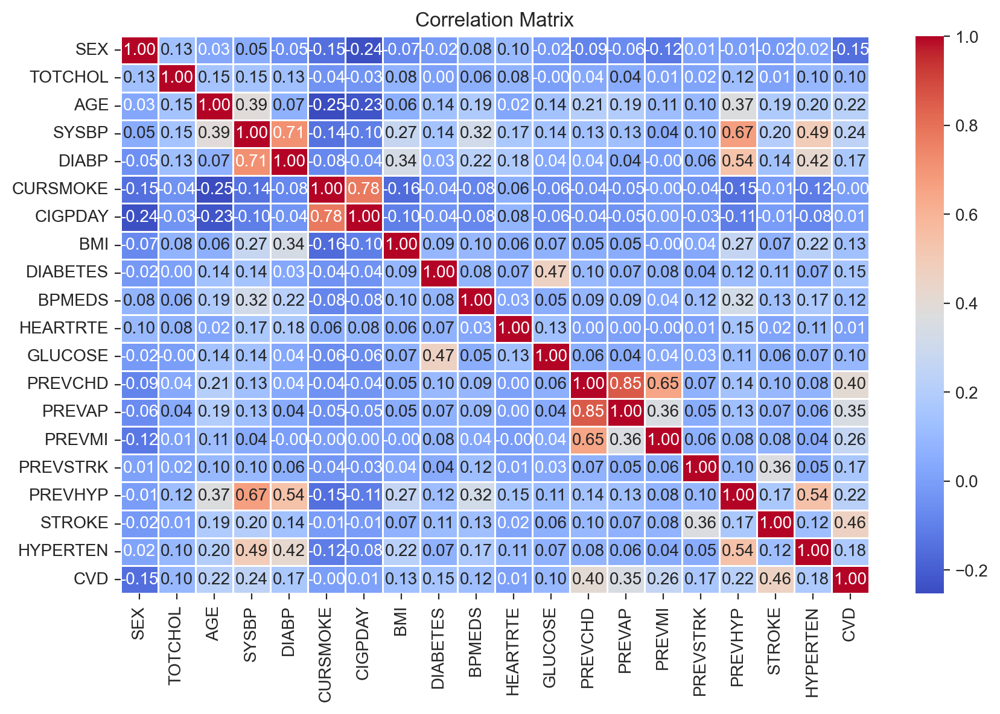

In [46]:
#Firstly, lets plot the correlation matrix to see features that are correlated

correlation_matrix = fr_heart.corr()

# Plotting the correlation matrix using a heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()


**Observation**  
The correlation plot above reveals significant relationships between various attributes:

- CURSMOKE & CIGPDAY are strongly correlated, with a correlation coefficient of 0.78.  
- DIABP & SYSBP also show a high correlation, with a value of 0.71.  
- PREVCHD & PREVAP are highly correlated, with a correlation coefficient of 0.85.  

Additionally, other features worth noting are:

- PREVHYP & SYSBP, which have a correlation value of 0.67.  
- PREVCHD & PREVMI, which show a correlation of 0.65.  

These correlations suggest a potential redundancy between some features, which should be considered during the modeling phase. However, for a comprehensive analysis, all features would be retained during EDA to ensure a thorough understanding of the data before any decisions on feature selection or removal are made.


In [20]:
#descriptive statistics
fr_heart[['AGE', 'TOTCHOL', 'SYSBP', 'DIABP', 'BMI', 'GLUCOSE', 'HEARTRTE']].describe()


,AGE,TOTCHOL,SYSBP,DIABP,BMI,GLUCOSE,HEARTRTE
count,11627.000000,11627.000000,11627.000000,11627.000000,11627.000000,11627.000000,11627.000000
mean,54.792810,241.051174,136.324116,83.037757,25.882763,84.124865,76.786359
std,9.564299,44.566676,22.798625,11.660144,4.105100,23.394762,12.465212
min,32.000000,107.000000,83.500000,30.000000,14.430000,39.000000,37.000000
25%,48.000000,211.000000,120.000000,75.000000,23.100000,73.000000,69.000000
50%,54.000000,238.000000,132.000000,82.000000,25.480000,82.000000,75.000000
75%,62.000000,267.000000,149.000000,90.000000,28.075000,87.000000,85.000000
max,81.000000,696.000000,295.000000,150.000000,56.800000,478.000000,220.000000


**Observation**   

TOTCHOL, SYSBP, DIABP, BMI, GLUCOSE, and HEARTRTE all exhibit signs of potential outliers, especially on the upper end of their ranges:

- TOTCHOL (Total Cholesterol): The range is from 107 to 696, with a mean of 241.05. The maximum value of 696 suggests the presence of significant outliers.  
- SYSBP (Systolic Blood Pressure): The range is from 83.5 to 295, with a mean of 136.32. The high maximum value of 295 could indicate outliers.  
- DIABP (Diastolic Blood Pressure): The range is from 30 to 150, with a mean of 83.04. The minimum value of 30 is particularly concerning and may warrant closer examination for potential data entry errors or extreme outliers.  
- BMI (Body Mass Index): The range is from 14.43 to 56.8, with a mean of 25.88. The upper range value of 56.8 could signify outliers.  
- GLUCOSE: The range is from 39 to 478, with a mean of 84.12. The maximum value of 478 is significantly higher than the 75th percentile (87), indicating substantial outliers.  
- HEARTRTE (Heart Rate): The range is from 37 to 220, with a mean of 76.79. The maximum value of 220 is abnormally high, suggesting potential outliers or errors. 
- The minimum value for DIABP (Diastolic Blood Pressure) at 30 is particularly concerning and may warrant closer examination for potential data entry errors or extreme outliers. This unusually low value falls far below the expected physiological range, suggesting the possibility of incorrect data entry or an anomaly that could skew the analysis if not addressed.


These outliers could significantly impact the models, particularly in the case of logistic regression or GLMs, where assumptions about the distribution of variables are critical. Therefore, it is important to investigate these values further and consider appropriate treatments to ensure robust model performance.

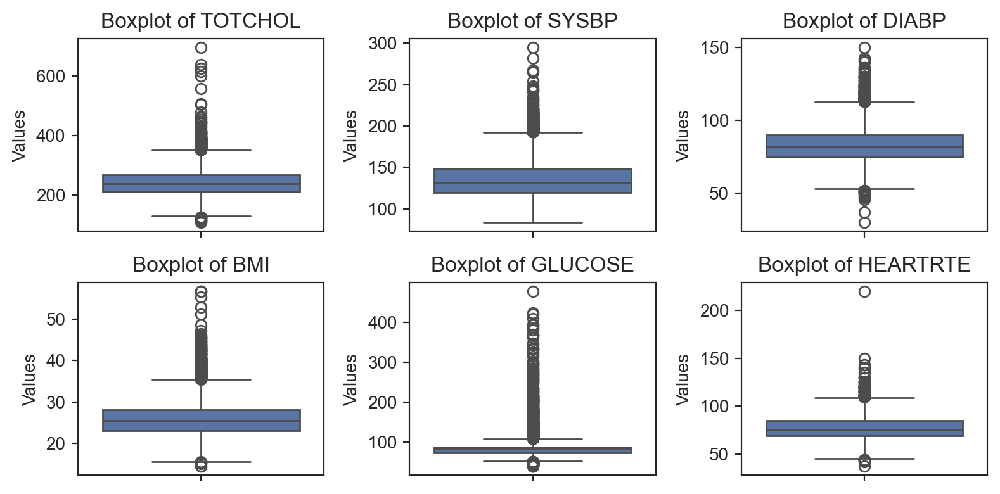

In [50]:

# List of features to visualize for outliers
features = ['TOTCHOL', 'SYSBP', 'DIABP', 'BMI', 'GLUCOSE', 'HEARTRTE']

# Set the size of the figure
plt.figure(figsize=(8, 4))

# Create a boxplot for each feature
for i, feature in enumerate(features, 1):
    plt.subplot(2, 3, i)
    sns.boxplot(y=fr_heart[feature])
    plt.title(f'Boxplot of {feature}')
    plt.ylabel('Values')

plt.tight_layout()  # Adjusts the plots so that they fit into the figure area
plt.show()


We can clearly see that these features contain outliers. We will address this EDA before building our model.

Now, lets start with univariate distribution  

**Univariate Distribution**  



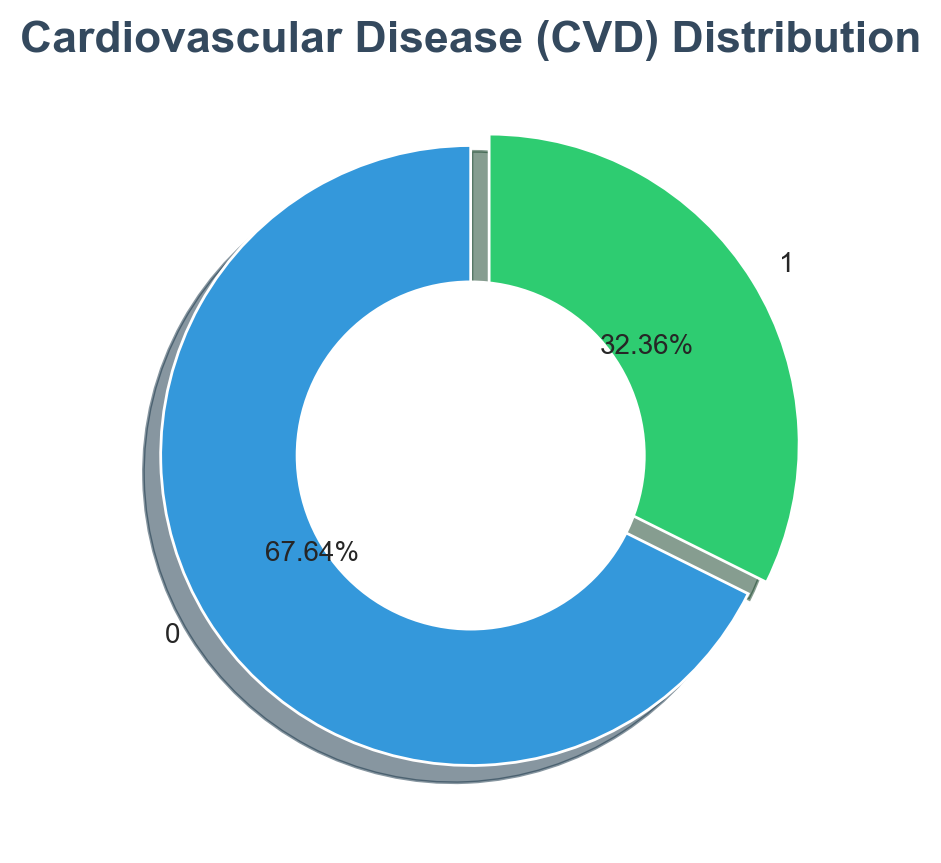

In [50]:
#Check the distribution of CVD 

# Count the occurrences of CVD
cvd_distribution = fr_heart['CVD'].value_counts()

# Define custom colors
colors = ['#3498db', '#2ecc71']

# Plot the pie chart
plt.figure(figsize=(5, 6))
plt.pie(cvd_distribution, labels=cvd_distribution.index, autopct='%1.2f%%', explode=[0, 0.07], shadow=True, colors=colors, startangle=90)
my_circle = plt.Circle((0, 0), 0.56, color='white')
p = plt.gcf()
p.gca().add_artist(my_circle)
plt.title('Cardiovascular Disease (CVD) Distribution', fontweight='bold', color='#34495e', fontsize=16)
plt.show()



### Observation

Approximately 25% of the population in the study develops Cardiovascular Disease (CVD). This indicates that the target variable is highly imbalanced, which can significantly affect the performance of statistical models, particularly those sensitive to class distribution. To address this imbalance, several strategies can be employed:

#### **1. Resampling Techniques:**

- **Oversampling:** Increase the number of instances in the minority class by duplicating or generating new instances.
- **Undersampling:** Reduce the number of instances in the majority class by removing some instances.
- **Generate Synthetic Samples:** Techniques such as the Synthetic Minority Over-sampling Technique (SMOTE) can be used to create synthetic instances for the minority class.

#### **2. Use of Alternative Evaluation Metrics:**

- Instead of relying solely on accuracy, it is advisable to use metrics better suited for imbalanced datasets, such as precision, recall, F1-score, or the area under the ROC curve (AUC-ROC).

#### **3. Ensemble Methods:**

- Ensemble methods like Random Forest and Gradient Boosting are typically more robust when dealing with class imbalance and can help improve model performance.

#### **4. Cost-sensitive Learning:**

- Implementing cost-sensitive learning involves adjusting the misclassification costs to be higher for the minority class, thereby placing more emphasis on correctly predicting the minority class.

#### **5. Anomaly Detection:**

- The minority class can be treated as an anomaly detection problem, identifying these cases as outliers within the dataset.

---

### Approach in This Study

In this study, we plan to implement four of the above-mentioned methods to address the class imbalance: **SMOTE and Evaluation Metrics**. This approach is intended to enhance model performance and ensure more accurate predictions for the minority class. 


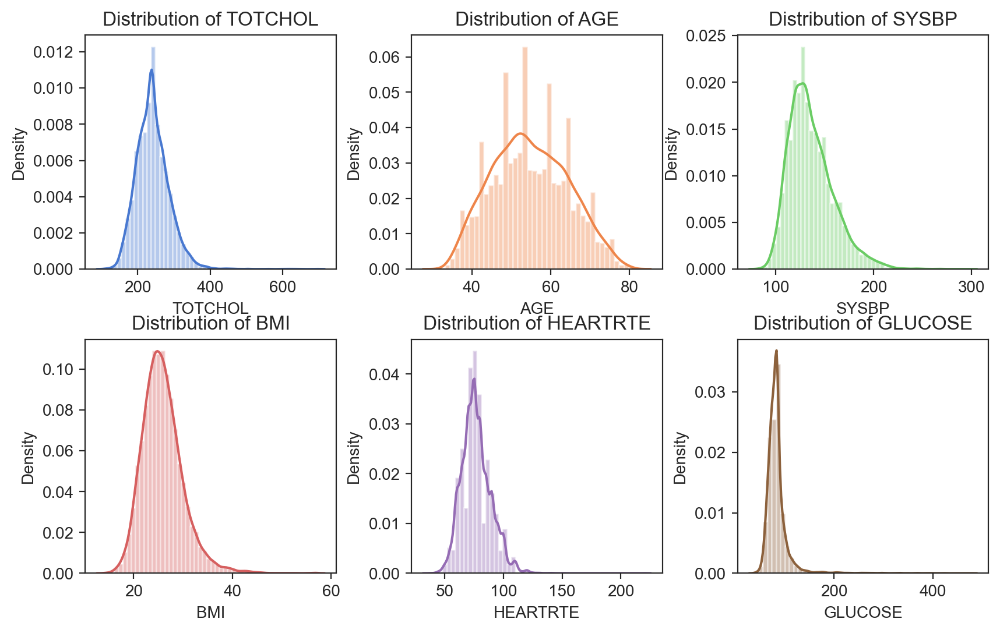

In [15]:
#Distribution of continous variables

# Create a figure with a 2x3 grid of subplots
plt.figure(figsize=(10, 6))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Plot distributions for continuous variables
variables = ['TOTCHOL', 'AGE', 'SYSBP', 'BMI', 'HEARTRTE', 'GLUCOSE']
colors = sns.color_palette("muted", len(variables))  # Use a color palette from seaborn

for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(2, 3, i + 1)
    sns.distplot(fr_heart[var], color=color)
    plt.title(f'Distribution of {var}')

# Display the figure with all distributions
plt.show()


## Observation:


#### Total Cholesterol (TOTCHOL) Distribution
The distribution of total cholesterol is right-skewed, indicating that most individuals have cholesterol levels on the lower end of the spectrum, with some having significantly higher levels. The skewness suggests potential outliers at the high end, which might need to be addressed or transformed (e.g., using a log transformation) for analysis.

#### Age (AGE) Distribution
The age distribution is approximately normal (bell-shaped), with most individuals in the middle age range. Age is well-distributed without apparent skewness or outliers, making it suitable for direct inclusion in models.

#### Systolic Blood Pressure (SYSBP) Distribution
The systolic blood pressure distribution is right-skewed, with most individuals having lower systolic blood pressure, but some having much higher readings. Like cholesterol, this skewness indicates potential outliers, and a transformation might help normalize the distribution.

#### Body Mass Index (BMI) Distribution
BMI shows a right-skewed distribution, with most individuals having BMI values in the lower range, but a few having very high values. This skewness might reflect the presence of outliers or individuals with obesity. Depending on the modeling approach, transformation or binning might be considered.

#### Heart Rate (HEARTRTE) Distribution
The heart rate distribution is right-skewed, with a cluster of individuals having normal heart rates, but a tail extending towards higher rates. This indicates potential outliers with unusually high heart rates, which could affect model assumptions and might need to be considered separately.

#### Glucose (GLUCOSE) Distribution
Glucose levels exhibit a strong right skew, with a large majority of individuals having lower glucose levels and a long tail extending to very high values. This heavy skewness likely reflects individuals with diabetes. 

The distributions indicate that most features have a slight to moderate right skew, with some outliers at the higher end. 

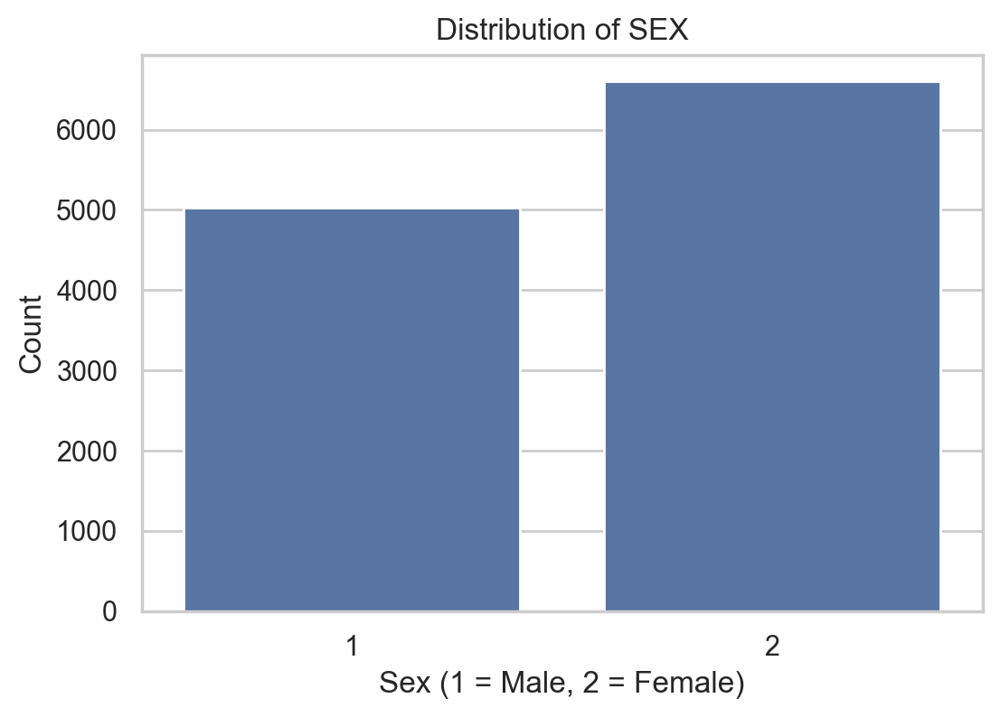

In [136]:
#Sex Distribution
sns.countplot(x='SEX', data=fram)
plt.title('Distribution of SEX')
plt.xlabel('Sex (1 = Male, 2 = Female)')
plt.ylabel('Count')
plt.show()


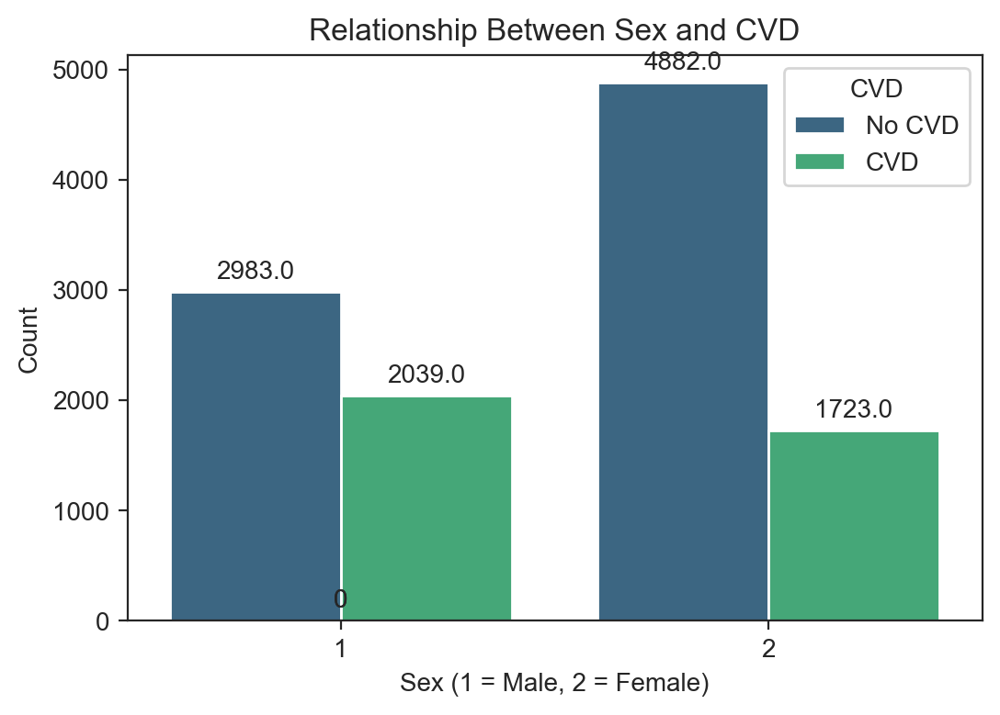

In [52]:
# Checking the relationship between sex and cvd
plt.figure(figsize=(6, 4))

# Create a count plot
ax = sns.countplot(data=fr_heart, x='SEX', hue='CVD', palette='viridis') 

# Add titles and labels
plt.title('Relationship Between Sex and CVD')
plt.xlabel('Sex (1 = Male, 2 = Female)')
plt.ylabel('Count')
plt.legend(title='CVD', loc='upper right', labels=['No CVD', 'CVD'])

# Annotate the bars with counts (corrected)
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', 
                xy=(p.get_x() + p.get_width() / 2, height), 
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom')

# Show plot
plt.show()


In [20]:
fr_heart.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'SYSBP', 'DIABP', 'CURSMOKE', 'CIGPDAY', 'BMI',
       'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'educ', 'PREVCHD',
       'PREVAP', 'PREVMI', 'PREVSTRK', 'PREVHYP', 'TIME', 'PERIOD', 'STROKE',
       'CVD', 'HYPERTEN'],
      dtype='object')

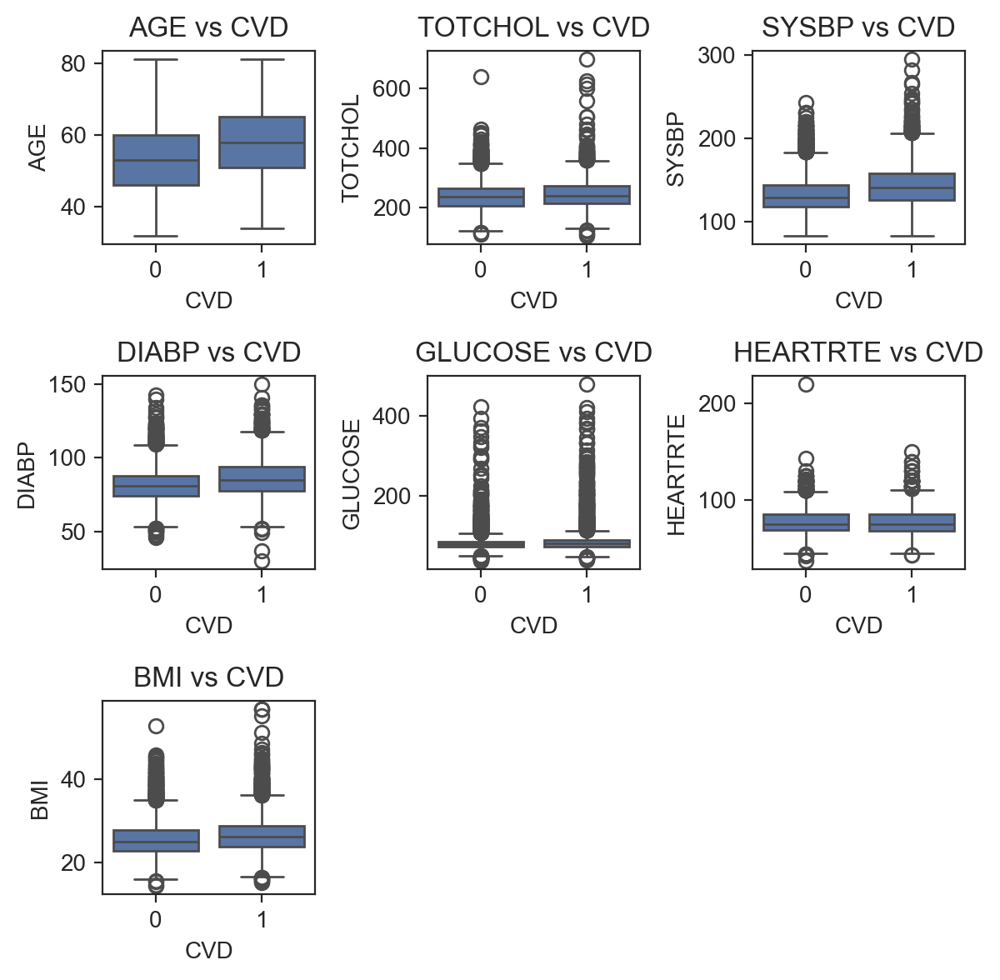

In [54]:

plt.figure(figsize=(6, 6))
features = ['AGE', 'TOTCHOL', 'SYSBP', 'DIABP', 'GLUCOSE', 'HEARTRTE', 'BMI']

for i, feature in enumerate(features, 1):
    plt.subplot(3, 3, i)  # 3x3 grid for 7 plots
    sns.boxplot(x='CVD', y=feature, data=fr_heart)
    plt.title(f'{feature} vs CVD')
    
plt.tight_layout()
plt.show()


### Observation

The box plots displayed depict the distribution of six key features—AGE, TOTCHOL (Total Cholesterol), SYSBP (Systolic Blood Pressure), DIABP (Diastolic Blood Pressure), GLUCOSE, and HEARTRTE (Heart Rate)—in relation to the presence or absence of Cardiovascular Disease (CVD). 
#### 1. **AGE vs CVD:**
   - Individuals with CVD have a higher median age compared to those without it.
   - This suggests that older individuals are more likely to develop CVD, in line with the known risk factor of age for cardiovascular diseases.

#### 2. **TOTCHOL (Total Cholesterol) vs CVD:**
   - Total cholesterol levels are slightly higher in individuals with CVD.
   - While there is some overlap, individuals with CVD tend to have a higher median cholesterol level, which is expected as high cholesterol is a known risk factor for heart disease.

#### 3. **SYSBP (Systolic Blood Pressure) vs CVD:**
   - The median systolic blood pressure is noticeably higher in individuals with CVD.
   - This indicates that individuals with elevated systolic blood pressure are more likely to have CVD, emphasizing the importance of managing blood pressure to prevent heart disease.

#### 4. **DIABP (Diastolic Blood Pressure) vs CVD:**
   - The distribution of diastolic blood pressure is similar between the two groups, but those with CVD still show a slightly higher median.
   - This suggests that diastolic blood pressure may also play a role in CVD, although its impact appears less pronounced compared to systolic blood pressure.

#### 5. **GLUCOSE vs CVD:**
   - Individuals with CVD have higher median glucose levels.
   - This reflects the relationship between glucose levels and CVD, likely due to the connection between diabetes and heart disease. Elevated glucose levels could indicate impaired glucose tolerance or diabetes, both risk factors for CVD.

#### 6. **HEARTRTE (Heart Rate) vs CVD:**
   - The heart rate distribution is relatively similar between the two groups, with a slightly higher median in individuals with CVD.
   - Heart rate alone may not be as strong a predictor of CVD, but combined with other factors, it could contribute to the overall risk assessment.  
   
####  7. BMI vs CVD
- The median BMI is slightly higher in the CVD group, and there are more high outliers compared to the non-CVD group. Higher BMI might be associated with an increased risk of CVD, though the difference is not as large as with some other variables like age or systolic blood pressure.

Overall, the box plots suggest that factors such as age, total cholesterol, systolic blood pressure, diastolic blood pressure, and glucose levels are positively associated with cardiovascular disease. These variables tend to have higher medians in individuals with CVD, indicating that they are important risk factors to consider in predictive modelling and risk assessment for heart disease.

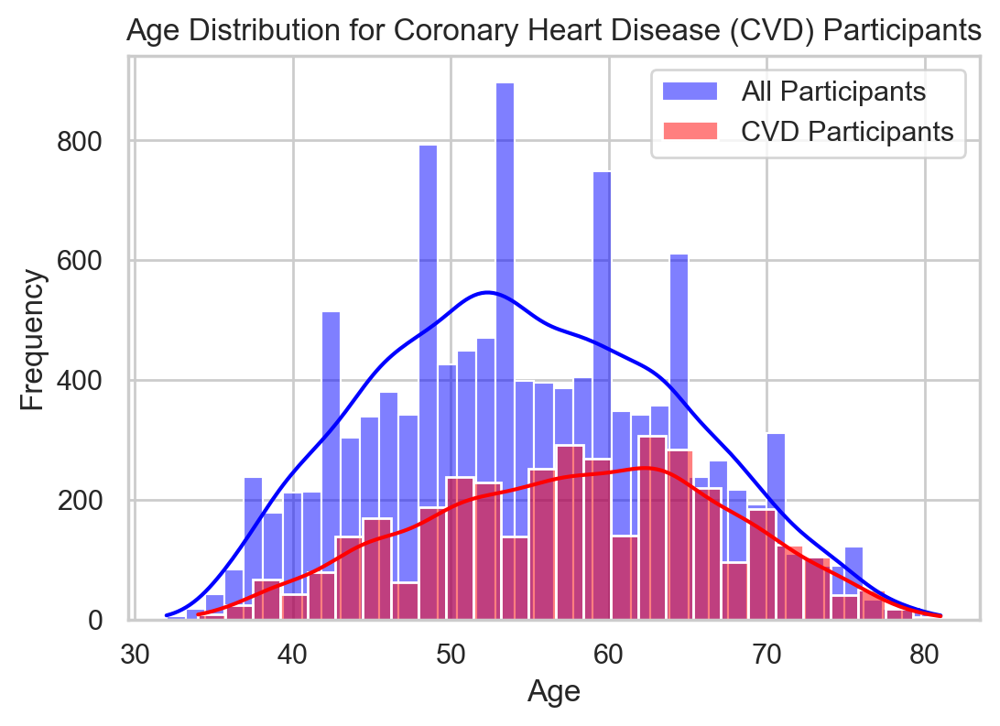

In [22]:
#Age Distribution of CVD

# Filter data for individuals with CVD (CVD = 1)
chd_data = fr_heart[fr_heart['CVD'] == 1]

# Plotting age distribution for individuals with and without CHD
plt.figure(figsize=(6, 4))
sns.histplot(fr_heart['AGE'], kde=True, label='All Participants', color='blue')
sns.histplot(chd_data['AGE'], kde=True, label='CVD Participants', color='red')
plt.title('Age Distribution for Coronary Heart Disease (CVD) Participants')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.legend()
plt.show()


### Observation

- The age distribution for all study participants peaks around 50 to 60 years, which is common in populations at risk for cardiovascular diseases.
- Participants with CHD/CVD also tend to be within the same age range, highlighting that CHD/CVD is more prevalent in middle-aged to older adults.
- The similar distribution patterns between the general population and those with CHD/CVD suggest that age is a significant risk factor for the development of these diseases, particularly for individuals aged 50 to 70 years.


In [23]:
fr_heart['AGE'].describe()

count    11627.000000
mean        54.792810
std          9.564299
min         32.000000
25%         48.000000
50%         54.000000
75%         62.000000
max         81.000000
Name: AGE, dtype: float64

In [24]:
# User-defined function for age encoding to give us an idea of different age group in the dataset using Quarters

fr_heart['AGE_GROUP'] = pd.cut(fr_heart['AGE'], 
                        bins=[32, 48, 54, 62, 81], 
                        labels=['Young Adults', 'Middle-Aged Adults', 'Older Adults', 'Senior Adults'], 
                        include_lowest=True)

# View the first few rows to verify
print(fr_heart[['AGE', 'AGE_GROUP']].head())


   AGE           AGE_GROUP
0   39        Young Adults
1   52  Middle-Aged Adults
2   46        Young Adults
3   52  Middle-Aged Adults
4   58        Older Adults


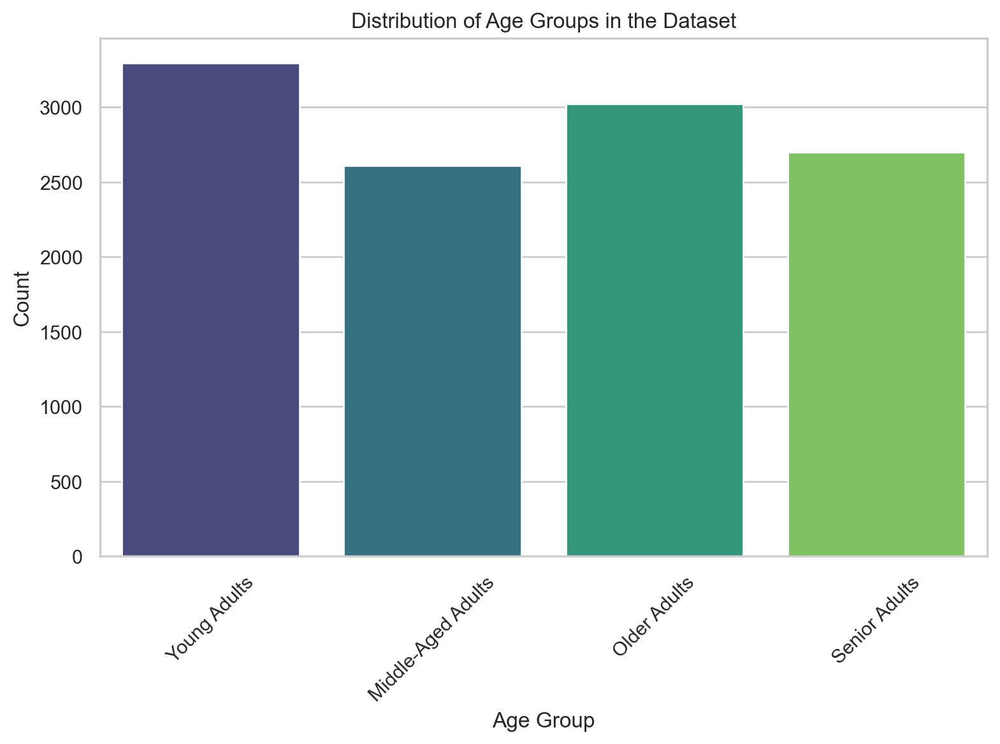

In [25]:

# Check the distribution of the age groups using a bar chart
age_group_counts = fr_heart['AGE_GROUP'].value_counts().sort_index()

# Set the color palette to viridis
sns.set_palette('viridis')

# Plotting the bar chart using seaborn
plt.figure(figsize=(8, 6))
sns.barplot(x=age_group_counts.index, y=age_group_counts.values, palette='viridis')

plt.xlabel('Age Group')
plt.ylabel('Count')
plt.title('Distribution of Age Groups in the Dataset')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


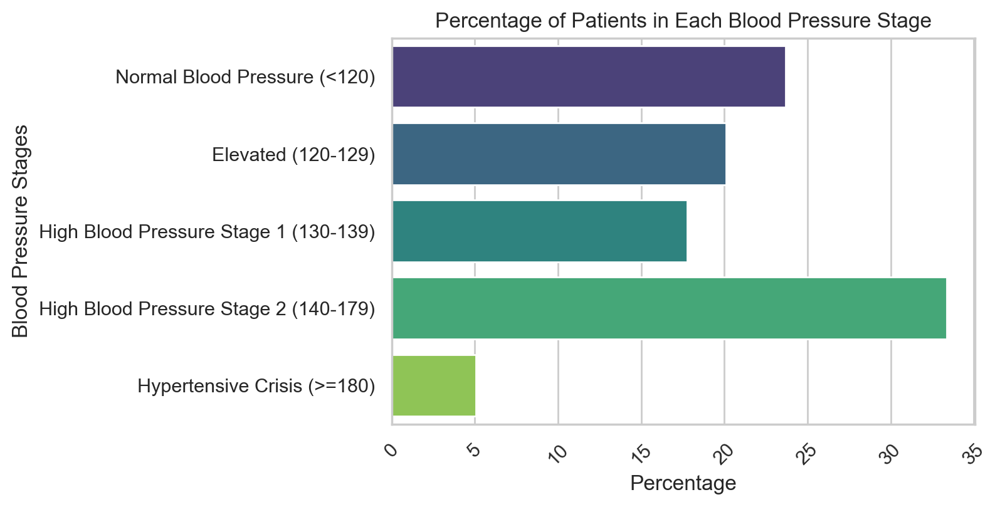

In [26]:
# Calculate the counts for each blood pressure stage
normal = len(fr_heart[fr_heart['SYSBP'] < 120])
elevated = len(fr_heart[fr_heart['SYSBP'].between(120, 129)])
hbpOne = len(fr_heart[fr_heart['SYSBP'].between(130, 139)])
hbpTwo = len(fr_heart[fr_heart['SYSBP'].between(140, 179)])
crisis = len(fr_heart[fr_heart['SYSBP'] >= 180])

# Create a list of blood pressure stages
blood_pressure_stages = [
    'Normal Blood Pressure (<120)',
    'Elevated (120-129)',
    'High Blood Pressure Stage 1 (130-139)',
    'High Blood Pressure Stage 2 (140-179)',
    'Hypertensive Crisis (>=180)'
]

# Create a list of counts and calculate the percentage for each stage
counts = [normal, elevated, hbpOne, hbpTwo, crisis]
total_count = sum(counts)
percentage = [count / total_count * 100 for count in counts]

# Set the plot style
sns.set(style="whitegrid")

# Create the bar plot
plt.figure(figsize=(6, 4))
sns.barplot(x=percentage, y=blood_pressure_stages, palette='viridis')

# Set the plot labels and title
plt.xlabel('Percentage')
plt.ylabel('Blood Pressure Stages')
plt.title('Percentage of Patients in Each Blood Pressure Stage')

# Rotate the x-axis labels for better readability
plt.xticks(rotation=45)

# Display the plot
plt.show()


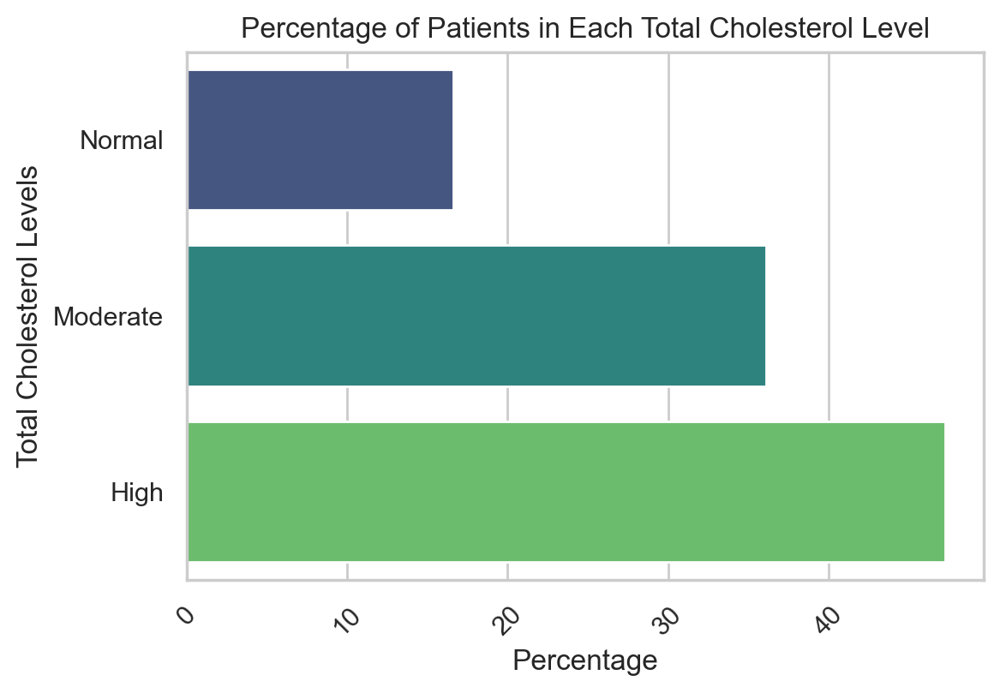

In [27]:
# Calculate counts for each TOTCHOL level
level_labels = ['Normal', 'Moderate', 'High']
level_ranges = [(0, 199), (200, 239), (240, 600)]
counts = [len(fr_heart[fr_heart['TOTCHOL'].between(low, high)]) for low, high in level_ranges]

# Calculate percentages
total_count = sum(counts)
percentages = [count / total_count * 100 for count in counts]

# Create the bar plot
sns.set(style="whitegrid")
plt.figure(figsize=(6, 4))
sns.barplot(x=percentages, y=level_labels, palette='viridis')

# Set plot labels and title
plt.xlabel('Percentage')
plt.ylabel('Total Cholesterol Levels')
plt.title('Percentage of Patients in Each Total Cholesterol Level')

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Display the plot
plt.show()


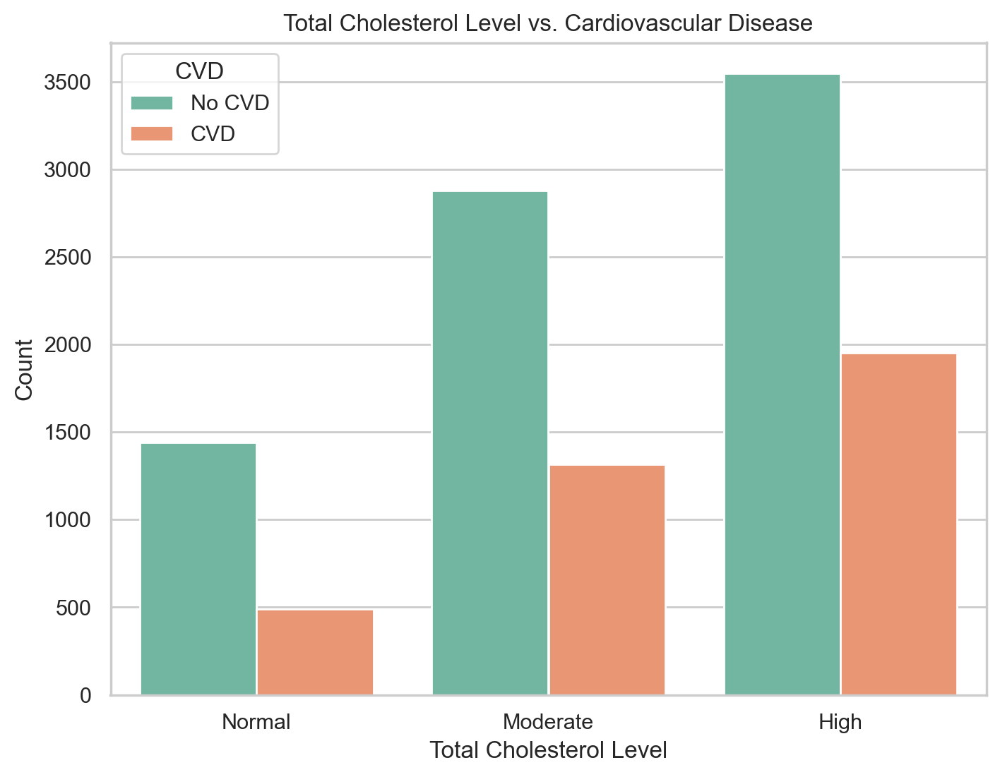

In [28]:
# Define the cholesterol levels
level_labels = ['Normal', 'Moderate', 'High']
level_ranges = [(0, 199), (200, 239), (240, 600)]

# Group the TOTCHOL values into levels
fr_heart['chol_level'] = pd.cut(fr_heart['TOTCHOL'], bins=[range[0] for range in level_ranges] + [level_ranges[-1][-1]],
                       labels=level_labels, right=False)

plt.figure(figsize=(8, 6))
sns.countplot(x='chol_level', hue='CVD', data=fr_heart, order=level_labels, palette='Set2')
plt.title('Total Cholesterol Level vs. Cardiovascular Disease')
plt.xlabel('Total Cholesterol Level')
plt.ylabel('Count')
plt.legend(title='CVD', labels=['No CVD', 'CVD'])

plt.show()



### Observations:  

#### Normal Cholesterol Level:

- The majority of individuals with normal cholesterol levels do not have CVD (represented by the green bars).
- A small proportion of individuals with normal cholesterol levels have CVD (represented by the orange bar).  

#### Moderate Cholesterol Level:

- Among those with moderate cholesterol levels, there is still a higher count of individuals without CVD compared to those with CVD, but the gap between the groups is smaller than in the normal cholesterol category.
- This suggests that as cholesterol levels increase from normal to moderate, the proportion of individuals with CVD increases.  

### High Cholesterol Level:

- In the high cholesterol category, the number of individuals with CVD is much closer to the number of individuals without CVD, although there are still more individuals without CVD.
- This indicates that high cholesterol levels are more frequently associated with CVD, with a relatively higher proportion of CVD cases compared to the normal and moderate categories.

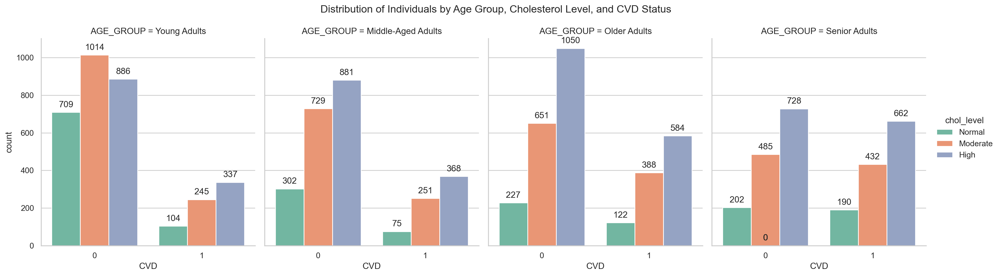

In [29]:
# Create the catplot with a diverse color palette
g = sns.catplot(
    x="CVD",
    hue="chol_level",
    col="AGE_GROUP",
    kind="count",
    data=fr_heart,
    palette="Set2",  # Use a color palette that's inclusive and accessible
    height=5,
    aspect=0.9
)

# Loop over each subplot (axes) to add bar labels
for ax in g.axes.flat:
    for p in ax.patches:
        ax.annotate(
            f'{int(p.get_height())}', 
            (p.get_x() + p.get_width() / 2., p.get_height()), 
            ha = 'center', 
            va = 'center', 
            xytext = (0, 10), 
            textcoords = 'offset points'
        )

# Customize plot elements for clarity
plt.xticks(rotation=0)  # Ensure x-axis labels are correctly oriented

# Adjust the main title placement and ensure proper spacing
g.fig.suptitle("Distribution of Individuals by Age Group, Cholesterol Level, and CVD Status", y=1.05)

# Show the plot
plt.show()


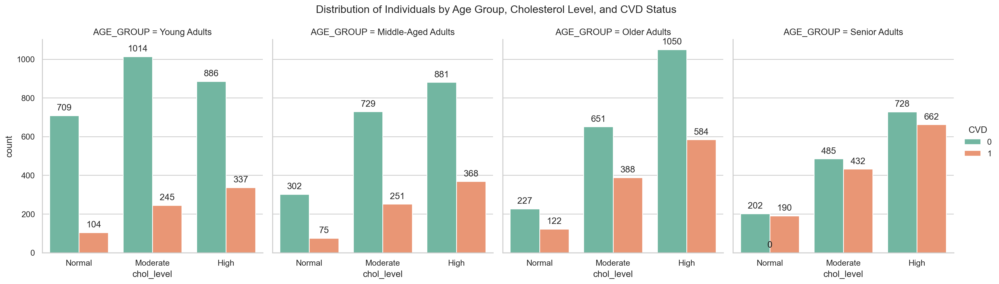

In [30]:
# Create the catplot with a diverse color palette
g = sns.catplot(
    x="chol_level",
    hue="CVD",
    col="AGE_GROUP",
    kind="count",
    data=fr_heart,
    palette="Set2",  # Use a color palette that's inclusive and accessible
    height=5,
    aspect=0.9
)

# Loop over each subplot (axes) to add bar labels
for ax in g.axes.flat:
    for p in ax.patches:
        ax.annotate(
            f'{int(p.get_height())}', 
            (p.get_x() + p.get_width() / 2., p.get_height()), 
            ha = 'center', 
            va = 'center', 
            xytext = (0, 10), 
            textcoords = 'offset points'
        )

# Customize plot elements for clarity
plt.xticks(rotation=0)  # Ensure x-axis labels are correctly oriented

# Adjust the main title placement and ensure proper spacing
g.fig.suptitle("Distribution of Individuals by Age Group, Cholesterol Level, and CVD Status", y=1.05)

# Show the plot
plt.show()


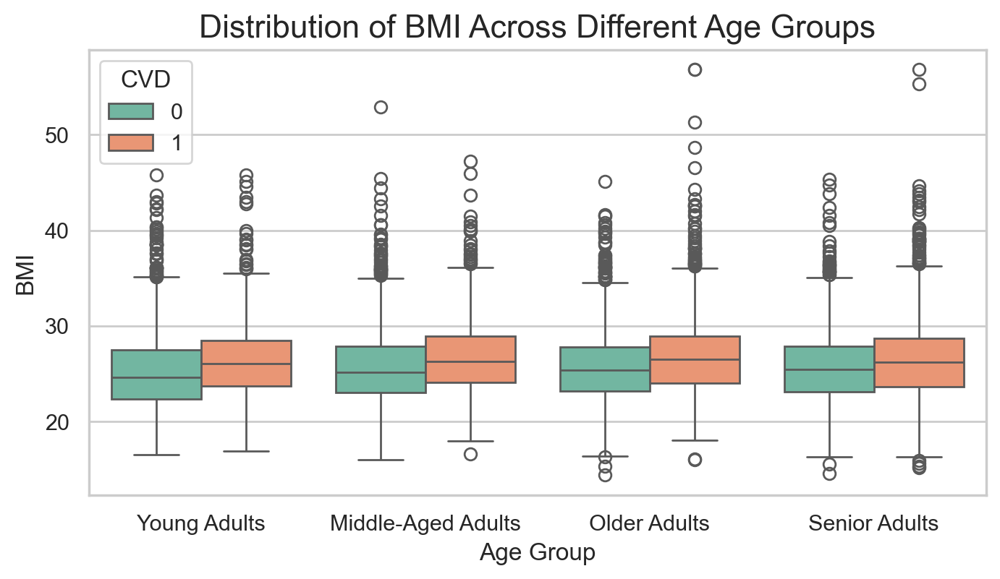

In [31]:

# Create a Violin plot for BMI across different Age Groups
sns.set(style="whitegrid")

# Plotting the data
plt.figure(figsize=(8, 4))
sns.boxplot(
    x="AGE_GROUP", 
    y="BMI",
    hue="CVD", 
    data=fr_heart, 
    palette="Set2", 
    #inner="quartile"  # Show the quartiles inside the violin plots
)

# Customize plot title and labels
plt.title("Distribution of BMI Across Different Age Groups", fontsize=16)
plt.xlabel("Age Group", fontsize=12)
plt.ylabel("BMI", fontsize=12)
plt.xticks(rotation=0)  # Ensure x labels are readable

plt.show()


### Observation:   

- As individuals age, the difference in BMI between those with and without CVD becomes more pronounced, especially among senior citizens. This could indicate that as age increases, BMI plays a more significant role in determining CVD risk.
- While BMI appears to be associated with CVD risk across all age groups, the relationship is stronger in older adults. 

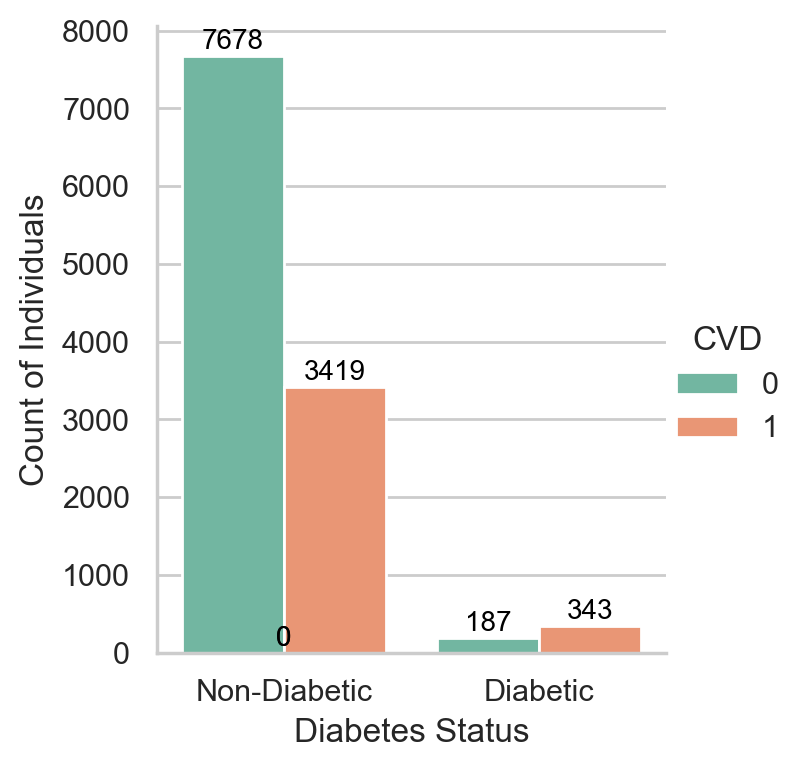

In [32]:
sns.set(style="whitegrid")
# Create a grouped bar plot
ax = sns.catplot(x='DIABETES', hue='CVD', kind='count', data=fr_heart, palette='Set2', height=4, aspect=0.9)
ax.set_axis_labels("Diabetes Status", "Count of Individuals")
ax.set_titles("Count of CVD Cases by Diabetes Status")
ax.set_xticklabels(['Non-Diabetic', 'Diabetic'])

# Add the counts on top of the bars
for p in ax.ax.patches:
    ax.ax.annotate(f'{int(p.get_height())}', 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                   textcoords='offset points')

plt.show()


Among diabetic individuals, a larger proportion have CVD (about 55.9%). This indicates a strong association between diabetes and CVD, with diabetics being more likely to develop cardiovascular disease compared to non-diabetics.

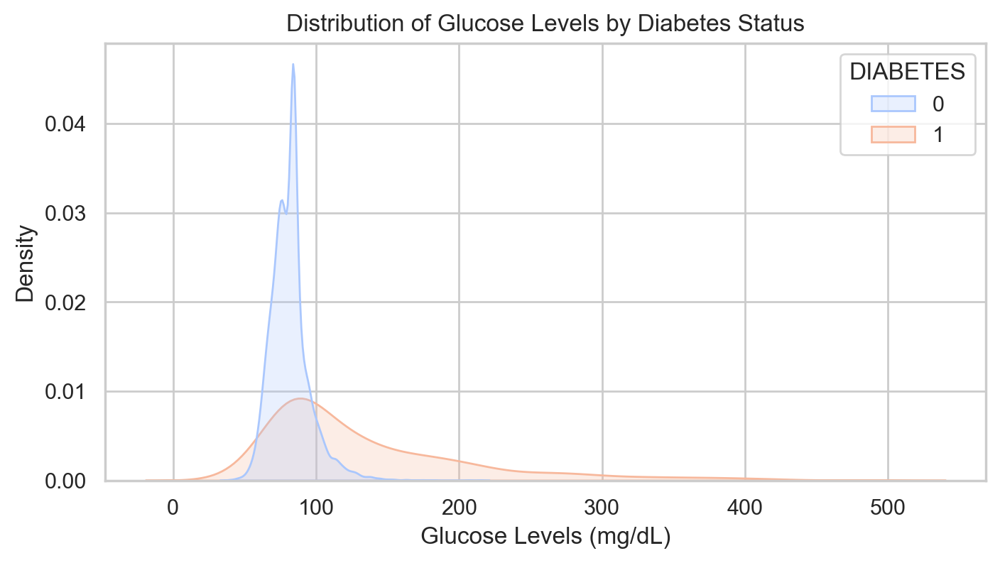

In [33]:

# Plot KDE of glucose levels for diabetic and non-diabetic individuals
plt.figure(figsize=(8, 4))
sns.kdeplot(
    data=fr_heart,
    x='GLUCOSE',
    hue='DIABETES',
    fill=True,
    palette='coolwarm',
    common_norm=False
)
plt.title('Distribution of Glucose Levels by Diabetes Status')
plt.xlabel('Glucose Levels (mg/dL)')
plt.ylabel('Density')
#plt.legend(title='Diabetes Status')
plt.show()


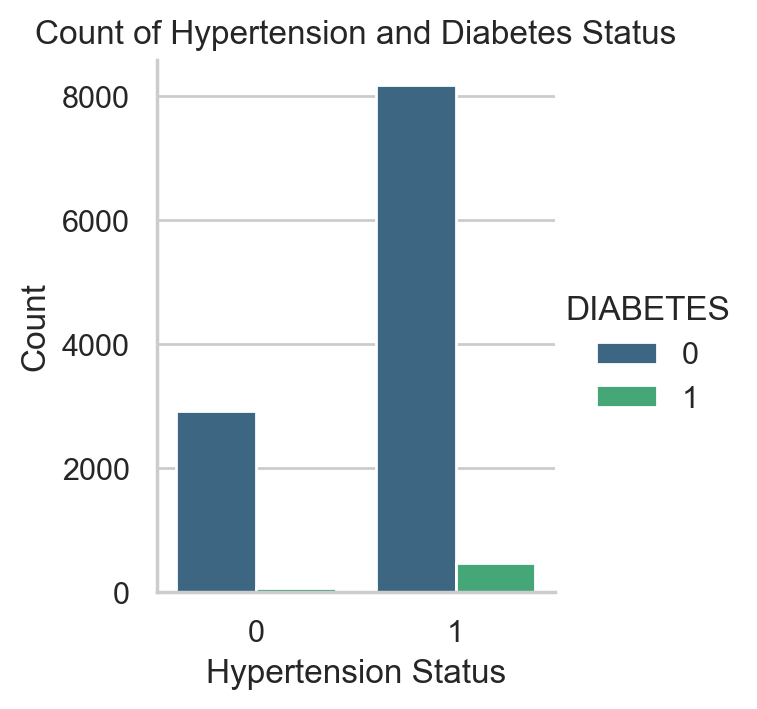

In [34]:
#Relationship between DIABETES and HYPERTENSION
sns.catplot(x='HYPERTEN', hue='DIABETES', kind='count', data=fr_heart, height=3.5, aspect=0.9, palette='viridis')
plt.title('Count of Hypertension and Diabetes Status')
plt.xlabel('Hypertension Status')
plt.ylabel('Count')
plt.show()


The chart shows that hypertension is common among both diabetic and non-diabetic individuals. However, it's rare for someone to have diabetes without also having hypertension. This suggests a strong association between the two conditions, indicating that individuals with diabetes are likely to also have hypertension.

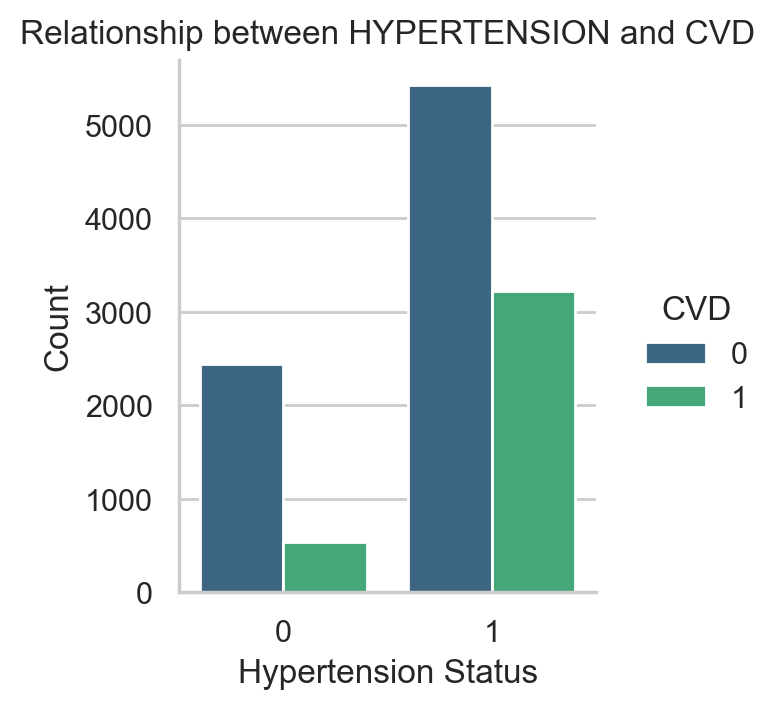

In [35]:
#Relationship between HYPERTENSION and CVD
sns.catplot(x='HYPERTEN', hue='CVD', kind='count', data=fr_heart, height=3.5, aspect=0.9, palette='viridis')
plt.title('Relationship between HYPERTENSION and CVD')
plt.xlabel('Hypertension Status')
plt.ylabel('Count')
plt.show()


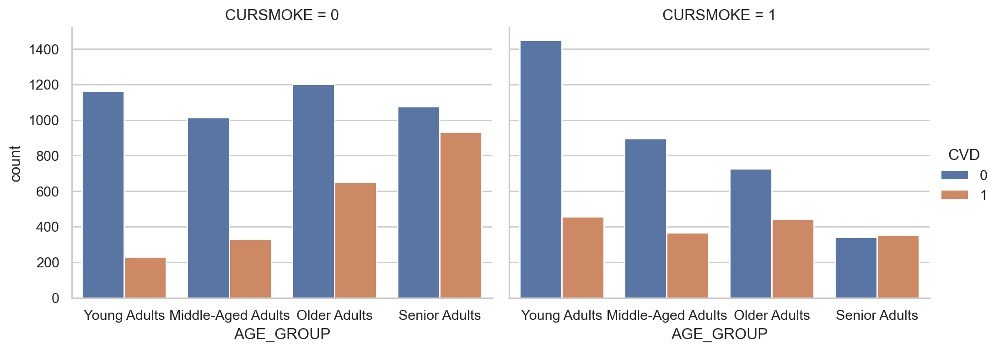

In [36]:
# Distribution of CVD by AGE GROUP and CURSMOKE

sns.catplot(
    x="AGE_GROUP", 
    hue="CVD", 
    col="CURSMOKE", 
    kind="count", 
    data=fr_heart,
    height=4,  # height of each facet
    aspect=1.3  # aspect ratio, width = aspect * height
)

# Show the plot
plt.show()



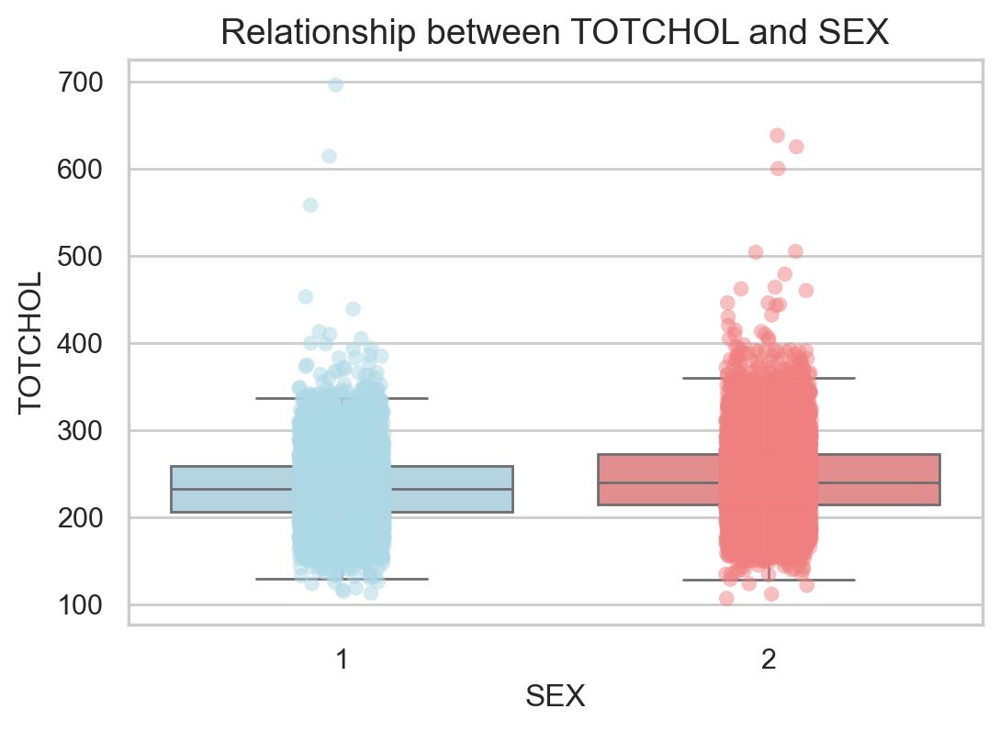

In [37]:
# Find the relationship between TOTCHOL and SEX

# Set style
sns.set(style="whitegrid")

# Define color palette with string keys
palette = {'1': "lightblue", '2': "lightcoral"}

# Convert the SEX column to string type to match the palette keys
fr_heart['SEX'] = fr_heart['SEX'].astype(str)

# Create a boxplot with color and style adjustments
plt.figure(figsize=(6, 4))
sns.boxplot(x='SEX', y='TOTCHOL', data=fr_heart, palette=palette, showfliers=False)
sns.stripplot(x='SEX', y='TOTCHOL', data=fr_heart, palette=palette, jitter=True, alpha=0.5, size=6, edgecolor='gray')

# Set labels and title
plt.xlabel('SEX', fontsize=12)
plt.ylabel('TOTCHOL', fontsize=12)
plt.title('Relationship between TOTCHOL and SEX', fontsize=14)

# Customize tick labels
#plt.xticks(ticks=[1, 2], labels=['Male', 'Female'])  

# Show the plot
plt.show()


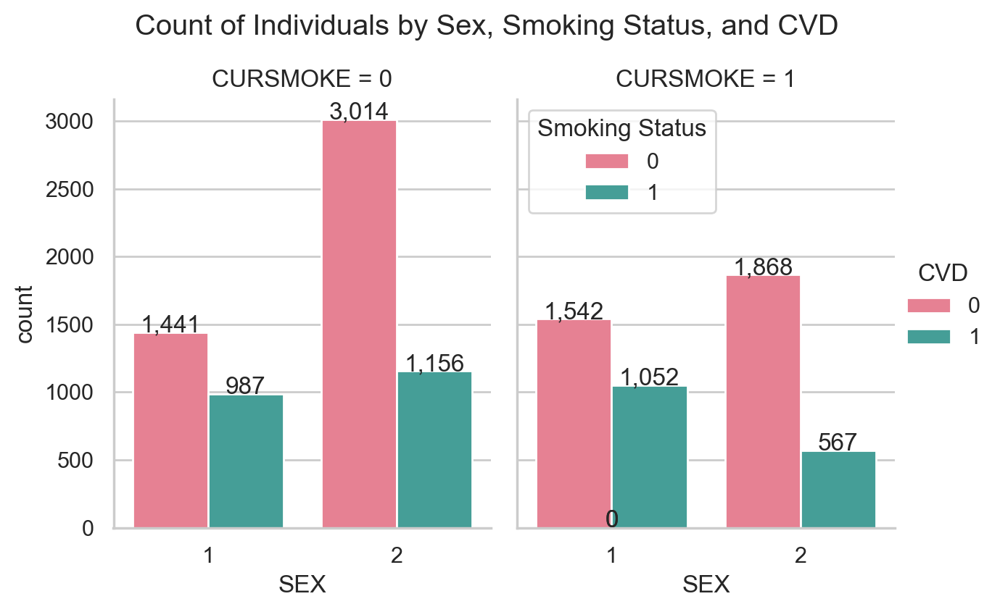

In [38]:
#Distribution of Individuals by Sex, Smoking Status, and CVD
sns.catplot(
    x="SEX", 
    hue="CVD", 
    col="CURSMOKE", 
    kind="count", 
    data=fr_heart,
    palette="husl",  # Use a vibrant color palette
    height=4,       # Adjust plot height for better readability
    aspect=0.8      # Adjust aspect ratio for better fit
)

# Customize plot elements for clarity and aesthetics
plt.xticks(rotation=0)  # Rotate x-axis labels for better visibility
plt.legend(title="Smoking Status", loc="upper left")  # Position legend appropriately
plt.suptitle("Count of Individuals by Sex, Smoking Status, and CVD", y=1.05)  # Add a clear title

# Add annotations for key insights
for ax in plt.gcf().axes:
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(
            f"{height:,.0f}",  # Format counts with commas for readability
            xy=(p.get_x() + p.get_width() / 2, height + 2),  # Position annotations above bars
            ha="center"
        )

plt.show()


### Interpretation:

#### CVD = 0 (No Cardiovascular Disease)

- **Males (SEX = 1)**:
  - The counts of non-smokers (1,624) and smokers (1,709) are almost equal, indicating that smoking status is relatively balanced among males without CVD.

- **Females (SEX = 2)**:
  - There are significantly more non-smokers (3,386) compared to smokers (2,009) among females without CVD, suggesting that non-smoking is more prevalent among females who do not have CVD.

#### CVD = 1 (Cardiovascular Disease)

- **Males (SEX = 1)**:
  - The counts of smokers (885) slightly exceed that of non-smokers (804), indicating that smoking may be more common among males with CVD.

- **Females (SEX = 2)**:
  - The number of non-smokers (784) is higher than the number of smokers (426), suggesting that even among females with CVD, non-smoking is more prevalent.




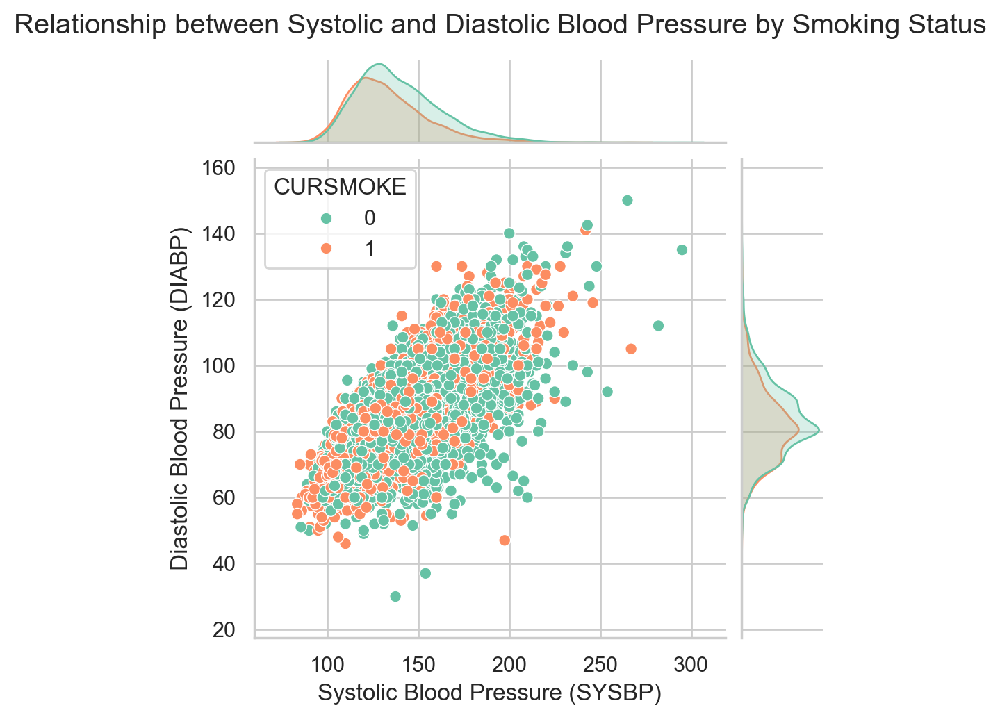

In [39]:
# Create a Jointplot for SYSBP vs. DIABP, segmented by smoking status
sns.set(style="whitegrid")

# Plot the data using a different color palette for smokers and non-smokers
g = sns.jointplot(
    x="SYSBP", 
    y="DIABP", 
    hue="CURSMOKE", 
    data=fr_heart, 
    kind="scatter", 
    palette="Set2", 
    height=5,
    #marginal_kws=dict(bins=30, fill=True)
)

# Customize plot title and labels
g.fig.suptitle("Relationship between Systolic and Diastolic Blood Pressure by Smoking Status", y=1.03)
g.set_axis_labels("Systolic Blood Pressure (SYSBP)", "Diastolic Blood Pressure (DIABP)")

plt.show()


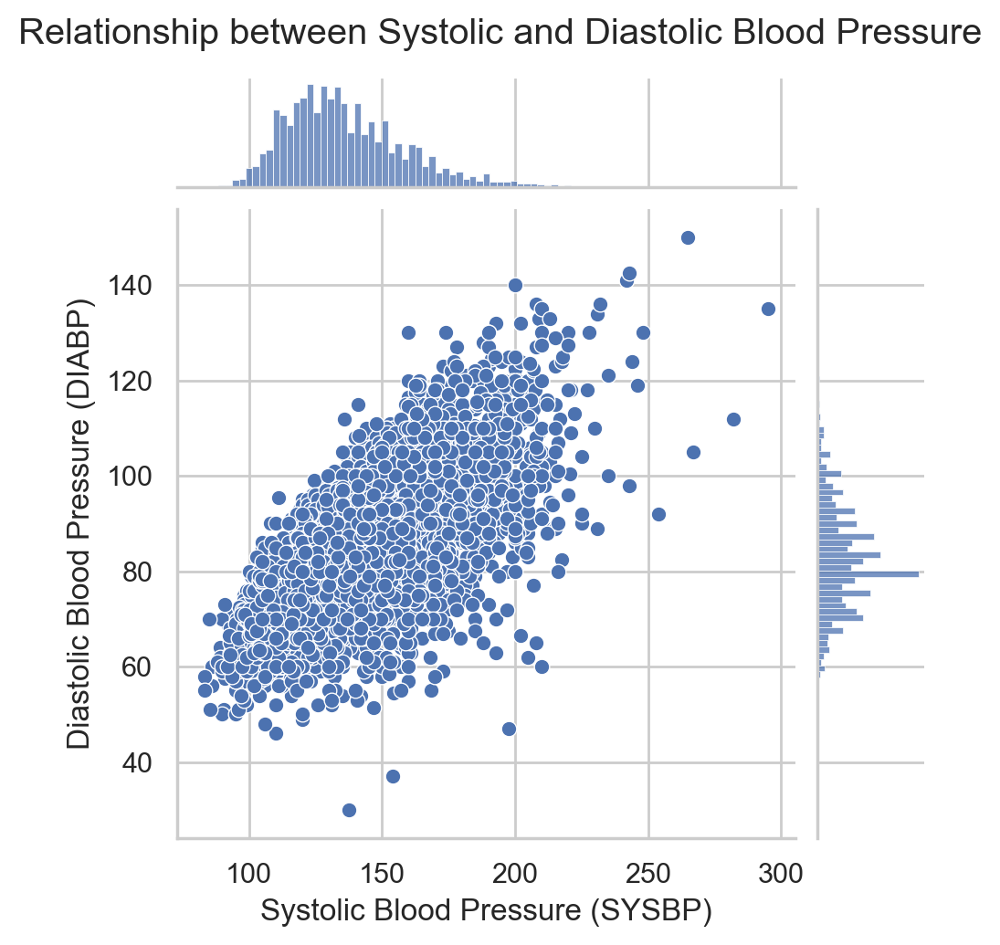

In [40]:
# Create a Jointplot for SYSBP vs. DIABP
sns.set(style="whitegrid")

# Plot the data using a different color palette for smokers and non-smokers
g = sns.jointplot(
    x="SYSBP", 
    y="DIABP", 
    #hue="CURSMOKE", 
    data=fr_heart, 
    kind="scatter", 
    palette="Set2", 
    height=5,
    #marginal_kws=dict(bins=30, fill=True)
)

# Customize plot title and labels
g.fig.suptitle("Relationship between Systolic and Diastolic Blood Pressure", y=1.03)
g.set_axis_labels("Systolic Blood Pressure (SYSBP)", "Diastolic Blood Pressure (DIABP)")

plt.show()


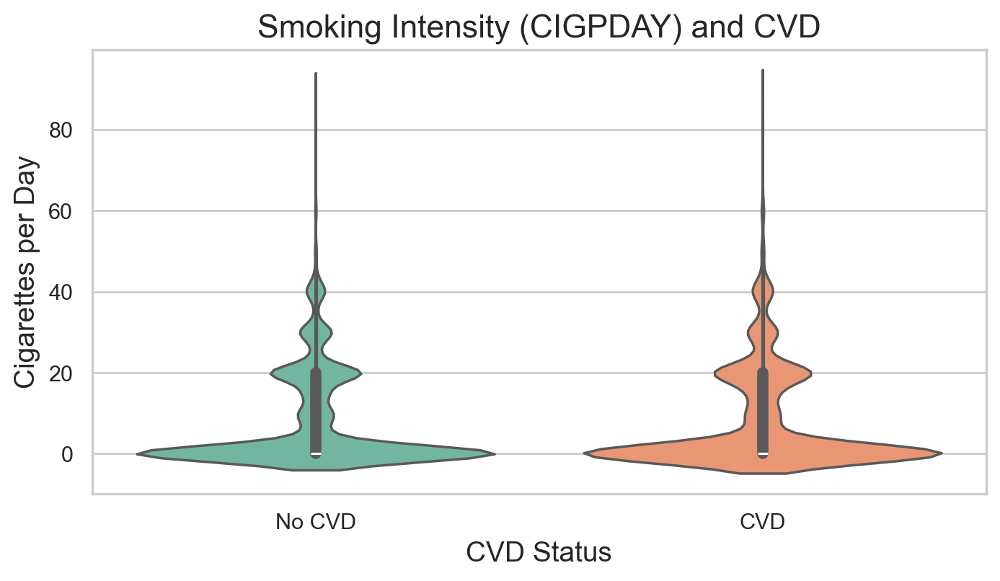

In [41]:

# Set the style for the plot
sns.set(style="whitegrid")

# Create the violin plot
plt.figure(figsize=(8, 4))
ax = sns.violinplot(
    x="CVD", 
    y="CIGPDAY", 
    data=fr_heart, 
    palette="Set2", 
    inner="box",  # Include a boxplot inside the violin plot
    scale="width"
)

# Customize the plot
plt.title("Smoking Intensity (CIGPDAY) and CVD", fontsize=16)
plt.xlabel("CVD Status", fontsize=14)
plt.ylabel("Cigarettes per Day", fontsize=14)
plt.xticks(ticks=[0, 1], labels=["No CVD", "CVD"])  # Add labels for CVD status

# Show the plot
plt.show()


The broader distribution of smoking intensity in the CVD group suggests a possible relationship between higher smoking intensity and the presence of cardiovascular disease. Individuals who smoke more heavily are more likely to be in the CVD group, which aligns with the well-established link between smoking and cardiovascular risk.

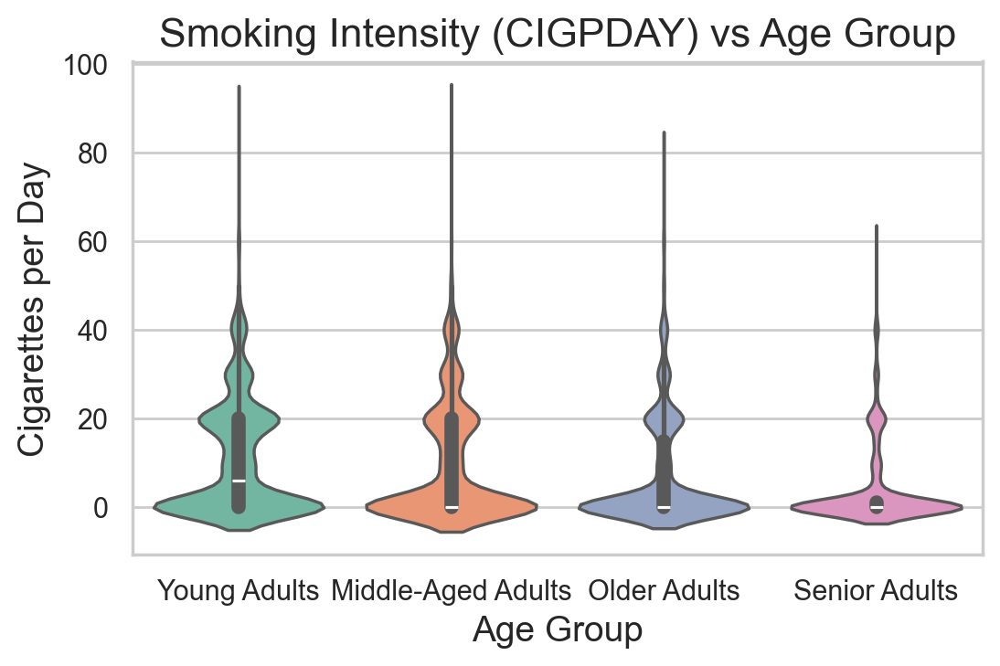

In [87]:

# Set the style for the plot
sns.set(style="whitegrid")

# Create the violin plot
plt.figure(figsize=(6, 3.5))
ax = sns.violinplot(
    x="AGE_GROUP", 
    y="CIGPDAY", 
    data=fr_heart, 
    palette="Set2", 
    inner="box",  # Include a boxplot inside the violin plot
    scale="width"
)


# Customize the plot
plt.title("Smoking Intensity (CIGPDAY) vs Age Group", fontsize=16)
plt.xlabel("Age Group", fontsize=14)
plt.ylabel("Cigarettes per Day", fontsize=14)

# Show the plot
plt.show()


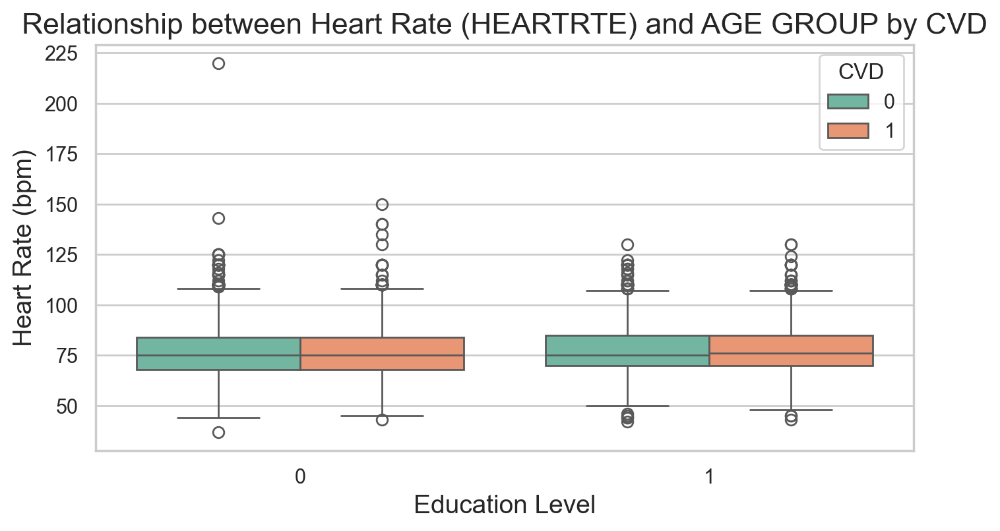

In [85]:

# Set the style for the plot
sns.set(style="whitegrid")

# Create the boxplot
plt.figure(figsize=(8, 4))
sns.boxplot(
    x="CURSMOKE", 
    y="HEARTRTE", 
    hue='CVD',
    data=fr_heart, 
    palette="Set2"
)

# Customize the plot
plt.title("Relationship between Heart Rate (HEARTRTE) and AGE GROUP by CVD", fontsize=16)
plt.xlabel("Education Level", fontsize=14)
plt.ylabel("Heart Rate (bpm)", fontsize=14)

# Show the plot
plt.show()


In [28]:
fr_heart.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'SYSBP', 'DIABP', 'CURSMOKE', 'CIGPDAY', 'BMI',
       'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'educ', 'PREVCHD',
       'PREVAP', 'PREVMI', 'PREVSTRK', 'PREVHYP', 'TIME', 'PERIOD', 'STROKE',
       'CVD', 'HYPERTEN'],
      dtype='object')

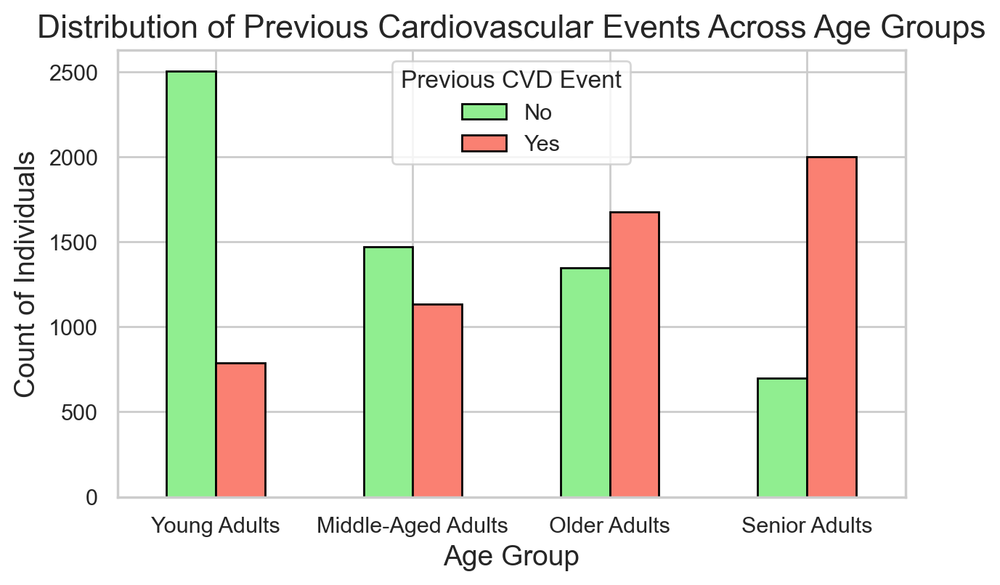

In [42]:

# Create a new column to represent whether an individual had any previous cardiovascular event
fr_heart['PREVIOUS_CVD_EVENT'] = fr_heart[['PREVCHD','PREVAP', 'PREVMI', 'PREVSTRK', 'PREVHYP',]].any(axis=1).astype(int)

# Set the style for the plot
sns.set(style="whitegrid")

# Group data by Age Group and Previous CVD Event
age_group_event = fr_heart.groupby(['AGE_GROUP', 'PREVIOUS_CVD_EVENT']).size().unstack()

# Plot the side-by-side bar plot
age_group_event.plot(kind='bar', stacked=False, color=['lightgreen', 'salmon'], edgecolor='black', figsize=(7, 4))

# Customize the plot
plt.title("Distribution of Previous Cardiovascular Events Across Age Groups", fontsize=16)
plt.xlabel("Age Group", fontsize=14)
plt.ylabel("Count of Individuals", fontsize=14)
plt.legend(title="Previous CVD Event", labels=["No", "Yes"])

# Adjust layout and show the plot
plt.xticks(rotation=0)
plt.show()


The chart shows a clear trend where the likelihood of having experienced a cardiovascular event increases with age. This is consistent with the understanding that age is a major risk factor for cardiovascular diseases.

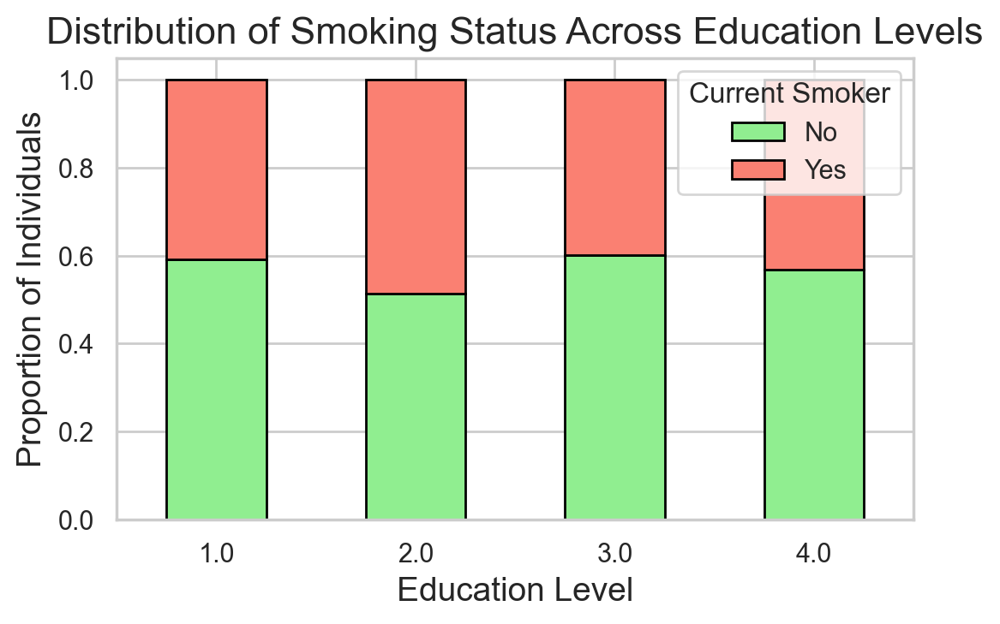

In [130]:
# Set the style for the plot
sns.set(style="whitegrid")

# Create a crosstab of education level and smoking status
smoking_education = pd.crosstab(fr_heart['educ'], fr_heart['CURSMOKE'])

# Normalize the crosstab to show proportions
smoking_education_norm = smoking_education.div(smoking_education.sum(axis=1), axis=0)

# Plot the stacked bar plot
smoking_education_norm.plot(kind='bar', stacked=True, color=['lightgreen', 'salmon'], edgecolor='black', figsize=(6, 3.5))

# Customize the plot
plt.title("Distribution of Smoking Status Across Education Levels", fontsize=16)
plt.xlabel("Education Level", fontsize=14)
plt.ylabel("Proportion of Individuals", fontsize=14)
plt.legend(title="Current Smoker", labels=["No", "Yes"])

# Adjust layout and show the plot
plt.xticks(rotation=0)
plt.show()


In [43]:
fr_heart.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'SYSBP', 'DIABP', 'CURSMOKE', 'CIGPDAY', 'BMI',
       'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'PREVCHD', 'PREVAP',
       'PREVMI', 'PREVSTRK', 'PREVHYP', 'STROKE', 'HYPERTEN', 'CVD',
       'PREVIOUS_CVD_EVENT', 'AGE_GROUP', 'chol_level'],
      dtype='object')

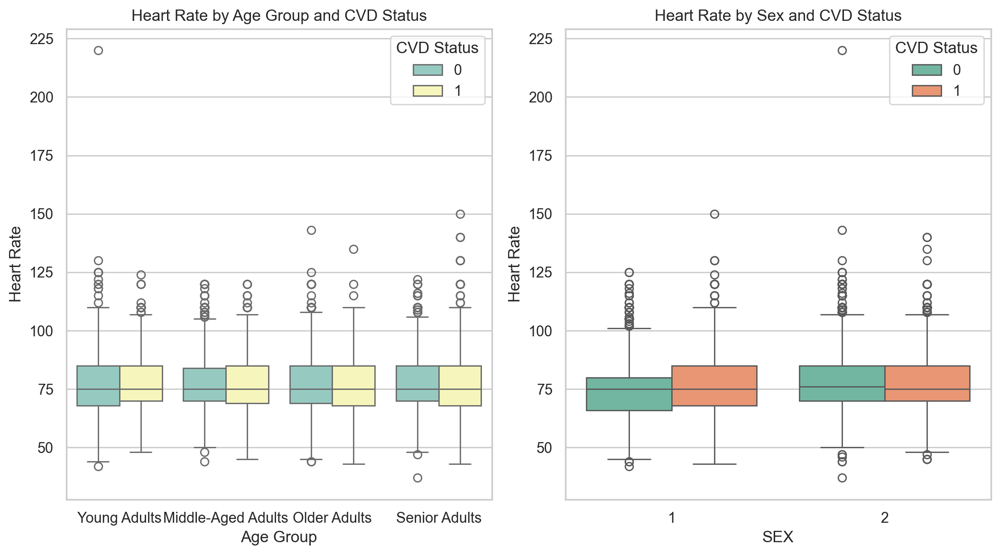

In [167]:

# Create a figure with 1 row and 2 columns for side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(10.7, 6))

# Plot 1: Heart Rate by Age Group and CVD Status
sns.boxplot(x='AGE_GROUP', y='HEARTRTE', hue='CVD', data=fr_heart, palette='Set3', ax=axes[0])
axes[0].set_title('Heart Rate by Age Group and CVD Status')
axes[0].set_xlabel('Age Group')
axes[0].set_ylabel('Heart Rate')
axes[0].legend(title='CVD Status')

# Plot 2: Heart Rate by Sex and CVD Status
sns.boxplot(x='SEX', y='HEARTRTE', hue='CVD', data=fr_heart, palette='Set2', ax=axes[1])
axes[1].set_title('Heart Rate by Sex and CVD Status')
axes[1].set_xlabel('SEX')
axes[1].set_ylabel('Heart Rate')
axes[1].legend(title='CVD Status')

# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()


In [44]:
#lets make a copy of the dataset
fram = fr_heart.copy()
fram.head(10)

,SEX,TOTCHOL,AGE,SYSBP,DIABP,CURSMOKE,CIGPDAY,BMI,DIABETES,BPMEDS,...,PREVAP,PREVMI,PREVSTRK,PREVHYP,STROKE,HYPERTEN,CVD,PREVIOUS_CVD_EVENT,AGE_GROUP,chol_level
0,1,195.0,39,106.0,70.0,0,0.0,26.97,0,0.0,...,0,0,0,0,0,0,1,0,Young Adults,Normal
1,1,209.0,52,121.0,66.0,0,0.0,26.97,0,0.0,...,0,0,0,0,0,0,1,0,Middle-Aged Adults,Moderate
2,2,250.0,46,121.0,81.0,0,0.0,28.73,0,0.0,...,0,0,0,0,0,0,0,0,Young Adults,High
3,2,260.0,52,105.0,69.5,0,0.0,29.43,0,0.0,...,0,0,0,0,0,0,0,0,Middle-Aged Adults,High
4,2,237.0,58,108.0,66.0,0,0.0,28.50,0,0.0,...,0,0,0,0,0,0,0,0,Older Adults,Moderate
5,1,245.0,48,127.5,80.0,1,20.0,25.34,0,0.0,...,0,0,0,0,0,0,0,0,Young Adults,High
6,1,283.0,54,141.0,89.0,1,30.0,25.34,0,0.0,...,0,0,0,0,0,0,0,0,Middle-Aged Adults,High
7,2,225.0,61,150.0,95.0,1,30.0,28.58,0,0.0,...,0,0,0,1,1,1,1,1,Older Adults,Moderate
8,2,232.0,67,183.0,109.0,1,20.0,30.18,0,0.0,...,0,0,0,1,1,1,1,1,Senior Adults,Moderate
9,2,285.0,46,130.0,84.0,1,23.0,23.10,0,0.0,...,0,0,0,0,0,1,0,0,Young Adults,High


In [45]:
fram.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'SYSBP', 'DIABP', 'CURSMOKE', 'CIGPDAY', 'BMI',
       'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'PREVCHD', 'PREVAP',
       'PREVMI', 'PREVSTRK', 'PREVHYP', 'STROKE', 'HYPERTEN', 'CVD',
       'PREVIOUS_CVD_EVENT', 'AGE_GROUP', 'chol_level'],
      dtype='object')

In [46]:
#MAP SYSBP AND DIABP TO GET BPMAP

# Calculate Mean Arterial Pressure (MAP) and add it as 'BPMAP'
fram['BPMAP'] = (fram['SYSBP'] * 1/3) + (fram['DIABP'] * 2/3)

# Display the updated DataFrame to verify the new 'BPMAP' column
print(fram[['SYSBP', 'DIABP', 'BPMAP']].head())  # showing only the first few rows for brevity


   SYSBP  DIABP      BPMAP
0  106.0   70.0  82.000000
1  121.0   66.0  84.333333
2  121.0   81.0  94.333333
3  105.0   69.5  81.333333
4  108.0   66.0  80.000000


In [47]:
fram.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'SYSBP', 'DIABP', 'CURSMOKE', 'CIGPDAY', 'BMI',
       'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'PREVCHD', 'PREVAP',
       'PREVMI', 'PREVSTRK', 'PREVHYP', 'STROKE', 'HYPERTEN', 'CVD',
       'PREVIOUS_CVD_EVENT', 'AGE_GROUP', 'chol_level', 'BPMAP'],
      dtype='object')

In [48]:
# List of features to remove
features_to_remove = ['CIGPDAY']

# Remove the specified features from the DataFrame
fram = fram.drop(features_to_remove, axis=1)
fram.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'SYSBP', 'DIABP', 'CURSMOKE', 'BMI',
       'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'PREVCHD', 'PREVAP',
       'PREVMI', 'PREVSTRK', 'PREVHYP', 'STROKE', 'HYPERTEN', 'CVD',
       'PREVIOUS_CVD_EVENT', 'AGE_GROUP', 'chol_level', 'BPMAP'],
      dtype='object')

In [49]:
# List of features to remove
features_to_remove = ['PREVCHD','STROKE',
       'PREVAP', 'PREVMI', 'PREVSTRK', 'PREVHYP', 'SYSBP','DIABP']

# Remove the specified features from the DataFrame
fram = fram.drop(features_to_remove, axis=1)
fram.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
       'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'CVD', 'PREVIOUS_CVD_EVENT',
       'AGE_GROUP', 'chol_level', 'BPMAP'],
      dtype='object')

In [34]:
fram.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
       'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'CVD', 'AGE_GROUP', 'chol_level',
       'PREVIOUS_CVD_EVENT', 'BPMAP'],
      dtype='object')

In [50]:
fram1 = fram.copy()
fram1.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
       'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'CVD', 'PREVIOUS_CVD_EVENT',
       'AGE_GROUP', 'chol_level', 'BPMAP'],
      dtype='object')

In [51]:
# Recode SEX: 0 for Female, 1 for Male
fram1['SEX'] = fram1['SEX'].replace({2: 0, 1: 1})

# Check the recoding
print(fram1['SEX'].value_counts())


SEX
2    6605
1    5022
Name: count, dtype: int64


In [96]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

# Specify features to use
features = ['SEX', 'TOTCHOL', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
            'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'AGE_GROUP', 'chol_level',
            'PREVIOUS_CVD_EVENT', 'BPMAP']
target = 'CVD'

# Split data into features and target
X = fram1[features]
y = fram1[target]

# One-hot encode categorical variables and standardize all variables
categorical_features = ['SEX', 'AGE_GROUP', 'chol_level', 'PREVIOUS_CVD_EVENT']
continuous_features = ['TOTCHOL', 'BMI', 'HEARTRTE', 'GLUCOSE', 'BPMAP']

# Column transformer to handle different types of preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), categorical_features),
        ('num', StandardScaler(), continuous_features)
    ]
)

# Apply preprocessor to the features
X_processed = preprocessor.fit_transform(X)

# Convert processed features back to a DataFrame with appropriate column names
processed_feature_names = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_features).tolist()
processed_feature_names += continuous_features
X_processed_df = pd.DataFrame(X_processed, columns=processed_feature_names)

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_processed_df, y, test_size=0.2, random_state=42)

# Fit the logistic regression model using MLE
X_train_const = sm.add_constant(X_train)
model = sm.Logit(y_train, X_train_const).fit(method='newton')

# Print the model summary
print(model.summary())

# Calculate odds ratios and 95% confidence intervals
odds_ratios = pd.DataFrame({
    'Feature': X_train_const.columns,
    'Odds Ratio': np.exp(model.params),
    'Lower 95% CI': np.exp(model.conf_int()[0]),
    'Upper 95% CI': np.exp(model.conf_int()[1])
})

# Display odds ratios
print("\nOdds Ratios and 95% Confidence Intervals:")
print(odds_ratios)

# Calculate Pseudo R-squared (McFadden's Pseudo R-squared)
null_model = sm.Logit(y_train, sm.add_constant(X_train_const[['const']])).fit(disp=0)
pseudo_r2 = 1 - model.llf / null_model.llf

# Evaluate the model on the test set
X_test_const = sm.add_constant(X_test)
y_pred_proba_test = model.predict(X_test_const)
y_pred_test = (y_pred_proba_test >= 0.5).astype(int)

# Calculate evaluation metrics
accuracy_test = accuracy_score(y_test, y_pred_test)
precision_test = precision_score(y_test, y_pred_test)
recall_test = recall_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test)

# Print the evaluation results
print("\nEvaluation Metrics for Refitted Model:")
print(f"Pseudo R-squared: {pseudo_r2:.4f}")
print(f"Accuracy: {accuracy_test:.4f}")
print(f"Precision: {precision_test:.4f}")
print(f"Recall: {recall_test:.4f}")
print(f"F1 Score: {f1_test:.4f}")
print(f"ROC AUC: {roc_auc_test:.4f}")
print(f"AIC: {model.aic:.4f}")
print(f"BIC: {model.bic:.4f}")


Optimization terminated successfully.
         Current function value: 0.557130
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                    CVD   No. Observations:                 9301
Model:                          Logit   Df Residuals:                     9287
Method:                           MLE   Df Model:                           13
Date:                Tue, 03 Sep 2024   Pseudo R-squ.:                  0.1153
Time:                        00:04:55   Log-Likelihood:                -5181.9
converged:                       True   LL-Null:                       -5857.1
Covariance Type:            nonrobust   LLR p-value:                7.239e-281
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -1.1249      0.079    -14.229      0.000      -1.280   

In [106]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

# Specify features to use
features = ['SEX', 'TOTCHOL', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
            'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'AGE_GROUP', 'chol_level',
            'PREVIOUS_CVD_EVENT', 'BPMAP']
target = 'CVD'

# Split data into features and target
X = fram1[features]
y = fram1[target]

# Correct classification: including CURSMOKE, DIABETES, BPMEDS, HYPERTEN as categorical
categorical_features = ['SEX', 'CURSMOKE', 'DIABETES', 'BPMEDS', 'HYPERTEN', 
                        'AGE_GROUP', 'chol_level', 'PREVIOUS_CVD_EVENT']
continuous_features = ['BMI', 'HEARTRTE', 'GLUCOSE', 'BPMAP']

# Column transformer to handle different types of preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), categorical_features),
        ('num', StandardScaler(), continuous_features)
    ]
)

# Apply preprocessor to the features
X_processed = preprocessor.fit_transform(X)

# Convert processed features back to a DataFrame with appropriate column names
processed_feature_names = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_features).tolist()
processed_feature_names += continuous_features
X_processed_df = pd.DataFrame(X_processed, columns=processed_feature_names)

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_processed_df, y, test_size=0.2, random_state=42)

# Fit the logistic regression model using MLE
X_train_const = sm.add_constant(X_train)
model = sm.Logit(y_train, X_train_const).fit(method='newton')

# Print the model summary
print(model.summary())

# Calculate odds ratios and 95% confidence intervals
odds_ratios = pd.DataFrame({
    'Feature': X_train_const.columns,
    'Odds Ratio': np.exp(model.params),
    'Lower 95% CI': np.exp(model.conf_int()[0]),
    'Upper 95% CI': np.exp(model.conf_int()[1])
})

# Display odds ratios
print("\nOdds Ratios and 95% Confidence Intervals:")
print(odds_ratios)

# Calculate Pseudo R-squared (McFadden's Pseudo R-squared)
null_model = sm.Logit(y_train, sm.add_constant(X_train_const[['const']])).fit(disp=0)
pseudo_r2 = 1 - model.llf / null_model.llf

# Evaluate the model on the test set
X_test_const = sm.add_constant(X_test)
y_pred_proba_test = model.predict(X_test_const)
y_pred_test = (y_pred_proba_test >= 0.5).astype(int)

# Calculate evaluation metrics
accuracy_test = accuracy_score(y_test, y_pred_test)
precision_test = precision_score(y_test, y_pred_test)
recall_test = recall_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test)

# Print the evaluation results
print("\nEvaluation Metrics for Refitted Model:")
print(f"Pseudo R-squared: {pseudo_r2:.4f}")
print(f"Accuracy: {accuracy_test:.4f}")
print(f"Precision: {precision_test:.4f}")
print(f"Recall: {recall_test:.4f}")
print(f"F1 Score: {f1_test:.4f}")
print(f"ROC AUC: {roc_auc_test:.4f}")
print(f"AIC: {model.aic:.4f}")
print(f"BIC: {model.bic:.4f}")


Optimization terminated successfully.
         Current function value: 0.552260
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                    CVD   No. Observations:                 9301
Model:                          Logit   Df Residuals:                     9284
Method:                           MLE   Df Model:                           16
Date:                Tue, 03 Sep 2024   Pseudo R-squ.:                  0.1230
Time:                        00:15:31   Log-Likelihood:                -5136.6
converged:                       True   LL-Null:                       -5857.1
Covariance Type:            nonrobust   LLR p-value:                2.429e-297
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -2.0856      0.089    -23.345      0.000      -2.261   

In [60]:
fram.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
       'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'CVD', 'PREVIOUS_CVD_EVENT',
       'AGE_GROUP', 'chol_level', 'BPMAP'],
      dtype='object')

In [61]:
fram2 = fram.copy()
fram2.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
       'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'CVD', 'PREVIOUS_CVD_EVENT',
       'AGE_GROUP', 'chol_level', 'BPMAP'],
      dtype='object')

In [62]:
# List of features to remove
features_to_remove = ['AGE_GROUP','chol_level']

# Remove the specified features from the DataFrame
fram2= fram2.drop(features_to_remove, axis=1)
fram2.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
       'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'CVD', 'PREVIOUS_CVD_EVENT',
       'BPMAP'],
      dtype='object')

In [72]:
fram2['SEX'].value_counts()

SEX
2    6605
1    5022
Name: count, dtype: int64

In [63]:
fram.sample(10)

,SEX,TOTCHOL,AGE,CURSMOKE,BMI,DIABETES,BPMEDS,HEARTRTE,GLUCOSE,HYPERTEN,CVD,PREVIOUS_CVD_EVENT,AGE_GROUP,chol_level,BPMAP
1133,2,266.0,64,0,24.06,0,0.0,75.0,80.000000,1,0,0,Senior Adults,High,94.166667
2308,2,247.0,52,0,27.26,0,0.0,69.0,63.000000,1,1,1,Middle-Aged Adults,High,107.333333
2337,1,300.0,67,0,29.10,0,0.0,68.0,93.000000,0,1,1,Senior Adults,High,87.333333
1748,2,336.0,68,0,28.31,0,0.0,81.0,88.000000,1,0,1,Senior Adults,High,109.333333
3391,2,282.0,55,1,21.68,0,0.0,80.0,87.000000,1,0,1,Older Adults,High,116.000000
1894,2,238.0,51,0,24.94,0,0.0,86.0,84.124865,1,0,0,Middle-Aged Adults,Moderate,91.666667
7795,1,172.0,48,1,35.12,1,0.0,75.0,108.000000,1,1,0,Young Adults,Normal,96.333333
2563,1,233.0,72,1,21.49,0,0.0,96.0,97.000000,1,1,1,Senior Adults,Moderate,124.666667
4599,2,183.0,46,1,21.84,0,0.0,56.0,69.000000,1,0,0,Young Adults,Normal,91.000000
9825,1,220.0,59,1,30.05,0,0.0,69.0,83.000000,1,1,1,Older Adults,Moderate,109.333333


In [73]:
# Recode SEX: 0 for Female, 1 for Male
fram2['SEX'] = fram2['SEX'].replace({2: 0, 1: 1})

# Check the recoding
print(fram2['SEX'].value_counts())


SEX
2    6605
1    5022
Name: count, dtype: int64


In [74]:
print(fram2['SEX'].unique())  # Check unique values in the SEX column


['1' '2']


In [76]:
# Check the data type of the 'SEX' column
print(fram2['SEX'].dtype)

# Check unique values in the 'SEX' column to ensure there are no unexpected values
print(fram2['SEX'].unique())


object
['1' '2']


In [77]:
# Convert SEX to integer (if it's not already)
fram2['SEX'] = fram2['SEX'].astype(int)


In [78]:
# Recode using map instead of replace
fram2['SEX'] = fram2['SEX'].map({2: 0, 1: 1})

# Check if the recoding worked
print(fram2['SEX'].value_counts())


SEX
0    6605
1    5022
Name: count, dtype: int64


In [67]:
print(fram2['SEX'].value_counts())


SEX
2    6605
1    5022
Name: count, dtype: int64


In [180]:
#checking significance of the predictors
import statsmodels.api as sm

# Define the outcome variable
outcome = 'CVD'

# List of predictors for univariate analysis
predictors = [
    'SEX', 'CURSMOKE', 'DIABETES', 'BPMEDS',
       'PREVIOUS_CVD_EVENT',
       'HYPERTEN', 'BPMAP', 'BMI', 'HEARTRTE', 'AGE',
       'TOTCHOL', 'GLUCOSE'
]
# Perform univariate logistic regression for each predictor
univariate_results = {}

for predictor in predictors:
    X = sm.add_constant(fram1[predictor]) 
    model = sm.Logit(fram1[outcome], X)
    
    try:
        result = model.fit(disp=0) # Suppress convergence output
        univariate_results[predictor] = result.summary2().tables[1] 
    except Exception as e:
        print(f"Error for {predictor}: {e}")
        univariate_results[predictor] = None  # Store None for failed models

# Display the univariate results for each predictor
for predictor, result in univariate_results.items():
    if result is not None:
        print(f"Univariate Logistic Regression for {predictor}:\n")
        print(result)
        print("\n" + "-"*80 + "\n")
    else:
        print(f"Univariate Logistic Regression for {predictor} failed to converge.\n")
        print("\n" + "-"*80 + "\n")


Univariate Logistic Regression for SEX:

          Coef.  Std.Err.          z          P>|z|    [0.025    0.975]
const -1.041488  0.028022 -37.167161  2.315953e-302 -1.096410 -0.986566
SEX    0.661018  0.040136  16.469515   6.075590e-61  0.582353  0.739683

--------------------------------------------------------------------------------

Univariate Logistic Regression for CURSMOKE:

             Coef.  Std.Err.          z          P>|z|    [0.025    0.975]
const    -0.731820  0.026289 -27.837694  1.517983e-170 -0.783345 -0.680295
CURSMOKE -0.013083  0.040025  -0.326875   7.437622e-01 -0.091531  0.065365

--------------------------------------------------------------------------------

Univariate Logistic Regression for DIABETES:

             Coef.  Std.Err.          z         P>|z|    [0.025    0.975]
const    -0.809011  0.020560 -39.348233  0.000000e+00 -0.849308 -0.768714
DIABETES  1.415633  0.093197  15.189603  4.144190e-52  1.232969  1.598297

-------------------------------------

In [182]:
#checking multicollinearity
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

# List of remaining features
features = [
    'SEX', 'CURSMOKE', 'DIABETES', 'BPMEDS',
       'PREVIOUS_CVD_EVENT','HYPERTEN', 'BPMAP', 'BMI', 'CVD','HEARTRTE', 'AGE',
       'TOTCHOL', 'GLUCOSE'
]

# Select only the chosen features
X = fram1[features]

# Add a constant column for the intercept
X = sm.add_constant(X)

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data["Feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

# Output the VIF values
print(vif_data)


               Feature         VIF
0                const  191.986008
1                  SEX    1.104358
2             CURSMOKE    1.142136
3             DIABETES    1.307691
4               BPMEDS    1.145598
5   PREVIOUS_CVD_EVENT    2.071380
6             HYPERTEN    1.468066
7                BPMAP    1.902426
8                  BMI    1.175384
9                  CVD    1.164961
10            HEARTRTE    1.084518
11                 AGE    1.296603
12             TOTCHOL    1.064948
13             GLUCOSE    1.307618


AGE         0
TOTCHOL     0
GLUCOSE     0
BPMAP       0
BMI         0
HEARTRTE    0
CVD         0
dtype: int64


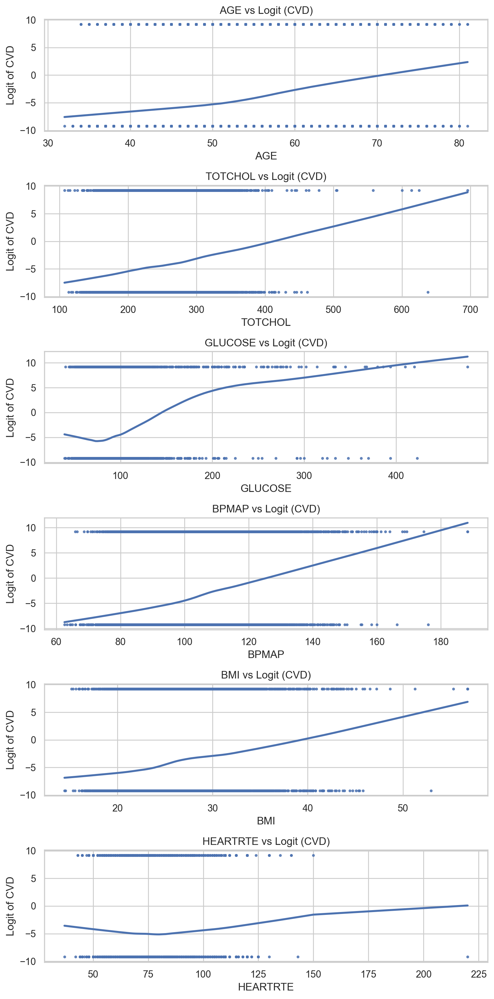

In [188]:
#Linearity check
# List of continuous predictors
continuous_vars = ['AGE', 'TOTCHOL', 'GLUCOSE', 'BPMAP', 'BMI', 'HEARTRTE']

# Check for missing values in 'CVD' or continuous variables
print(fram1[continuous_vars + ['CVD']].isnull().sum())

# Ensure 'CVD' is binary and does not contain missing values
fram1 = fram1.dropna(subset=['CVD'] + continuous_vars)

# Prevent division by zero in the logit transformation by adding a small constant
fram1['logit'] = np.log((fram1['CVD'] + 0.0001) / (1 - fram1['CVD'] + 0.0001))

# Plot each continuous variable against the logit
fig, axes = plt.subplots(len(continuous_vars), 1, figsize=(8, 16))

for i, var in enumerate(continuous_vars):
    if var in fram1.columns:  # Ensure the variable is in the dataframe
        sns.regplot(x=fram1[var], y=fram1['logit'], lowess=True, ax=axes[i], scatter_kws={'s': 5})
        axes[i].set_title(f'{var} vs Logit (CVD)')
        axes[i].set_ylabel('Logit of CVD')
    else:
        print(f"{var} not found in dataframe")
    
plt.tight_layout()
plt.show()


## BASELINE MODEL

Optimization terminated successfully.
         Current function value: 0.548876
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                    CVD   No. Observations:                 6975
Model:                          Logit   Df Residuals:                     6962
Method:                           MLE   Df Model:                           12
Date:                Thu, 19 Sep 2024   Pseudo R-squ.:                  0.1246
Time:                        20:33:47   Log-Likelihood:                -3828.4
converged:                       True   LL-Null:                       -4373.2
Covariance Type:            nonrobust   LLR p-value:                1.046e-225
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.9009      0.029    -30.589      0.000      -0.959      -0.843
SEX  

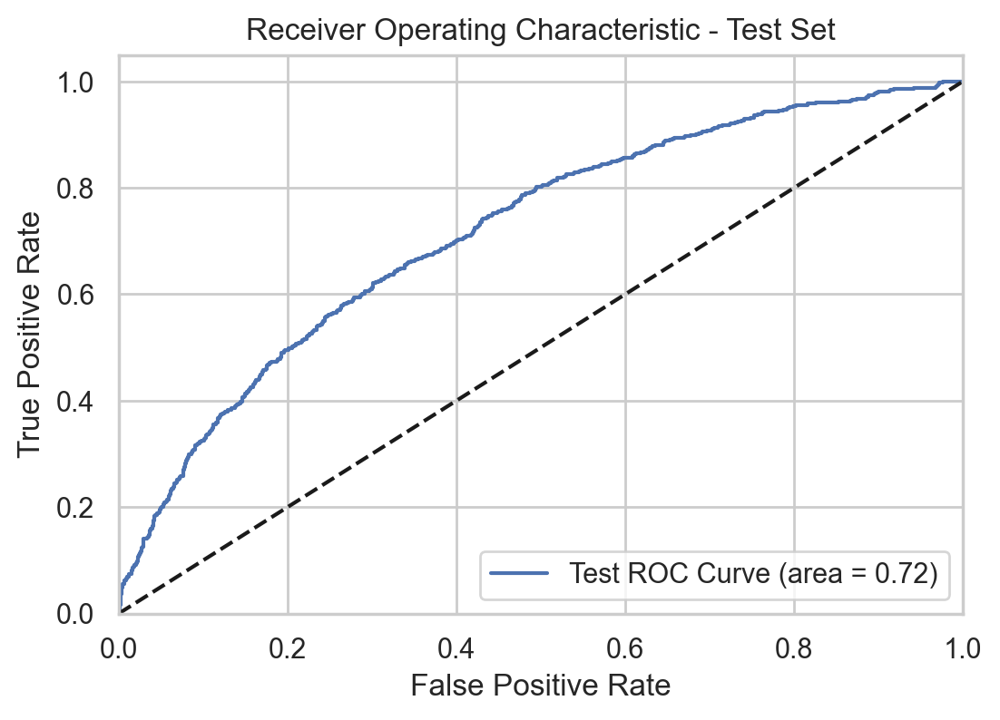

In [133]:
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
import pandas as pd

# Define features and target
X = fram2.drop('CVD', axis=1)
y = fram2['CVD']

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns=X.columns)  # Retain column names after scaling

# Split data into train, validation, and test sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=42)  # 0.15 x 0.9 = 0.2

# Fit a Logistic Regression model using MLE
X_train_const = sm.add_constant(X_train)  # Adding a constant for intercept
model = sm.Logit(y_train, X_train_const).fit()

# Print the model summary
print(model.summary())

# Calculate odds ratios and 95% confidence intervals
odds_ratios = pd.DataFrame({
    'Feature': X_train_const.columns,
    'Odds Ratio': model.params.apply(lambda x: round(np.exp(x), 4)),
    'Lower 95% CI': model.conf_int()[0].apply(lambda x: round(np.exp(x), 4)),
    'Upper 95% CI': model.conf_int()[1].apply(lambda x: round(np.exp(x), 4))
})



# Display odds ratios
print("\nOdds Ratios and 95% Confidence Intervals:")
print(odds_ratios)

# Evaluate the model on the validation set
X_val_const = sm.add_constant(X_val)  # Add constant to validation set
y_pred_proba_val = model.predict(X_val_const)
y_pred_val = (y_pred_proba_val >= 0.5).astype(int)

# Evaluation metrics for validation set
accuracy_val = accuracy_score(y_val, y_pred_val)
precision_val = precision_score(y_val, y_pred_val)
recall_val = recall_score(y_val, y_pred_val)
f1_val = f1_score(y_val, y_pred_val)
roc_auc_val = roc_auc_score(y_val, y_pred_proba_val)

# Evaluate the model on the test set
X_test_const = sm.add_constant(X_test)  # Add constant to test set
y_pred_proba_test = model.predict(X_test_const)
y_pred_test = (y_pred_proba_test >= 0.5).astype(int)

# Evaluation metrics for test set
accuracy_test = accuracy_score(y_test, y_pred_test)
precision_test = precision_score(y_test, y_pred_test)
recall_test = recall_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test)

# Print evaluation metrics
print("Validation Set Metrics:")
print(f"Accuracy: {accuracy_val:.4f}, Precision: {precision_val:.4f}, Recall: {recall_val:.4f}, F1 Score: {f1_val:.4f}, ROC AUC: {roc_auc_val:.4f}")
print("Test Set Metrics:")
print(f"Accuracy: {accuracy_test:.4f}, Precision: {precision_test:.4f}, Recall: {recall_test:.4f}, F1 Score: {f1_test:.4f}, ROC AUC: {roc_auc_test:.4f}")

# Plot ROC curve for test set
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba_test)
plt.figure()
plt.plot(fpr, tpr, label=f'Test ROC Curve (area = {roc_auc_test:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Test Set')
plt.legend(loc="lower right")
plt.show()


In [244]:
fram2.columns

Index(['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
       'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'CVD', 'PREVIOUS_CVD_EVENT',
       'BPMAP'],
      dtype='object')

## SMOTE



Odds Ratios for each feature:
               Feature  Odds Ratio
0                  SEX    1.494204
1              TOTCHOL    1.242374
2                  AGE    1.424772
3             CURSMOKE    1.150325
4                  BMI    1.165800
5             DIABETES    1.184828
6               BPMEDS    1.072638
7             HEARTRTE    0.901434
8              GLUCOSE    1.038715
9             HYPERTEN    1.118847
10  PREVIOUS_CVD_EVENT    1.497949
11               BPMAP    1.060406

Validation Set Metrics:
Accuracy: 0.6767
Precision: 0.5127
Recall: 0.7009
F1 Score: 0.5922
ROC AUC: 0.7335

Test Set Metrics:
Accuracy: 0.6513
Precision: 0.4711
Recall: 0.6640
F1 Score: 0.5512
ROC AUC: 0.7164


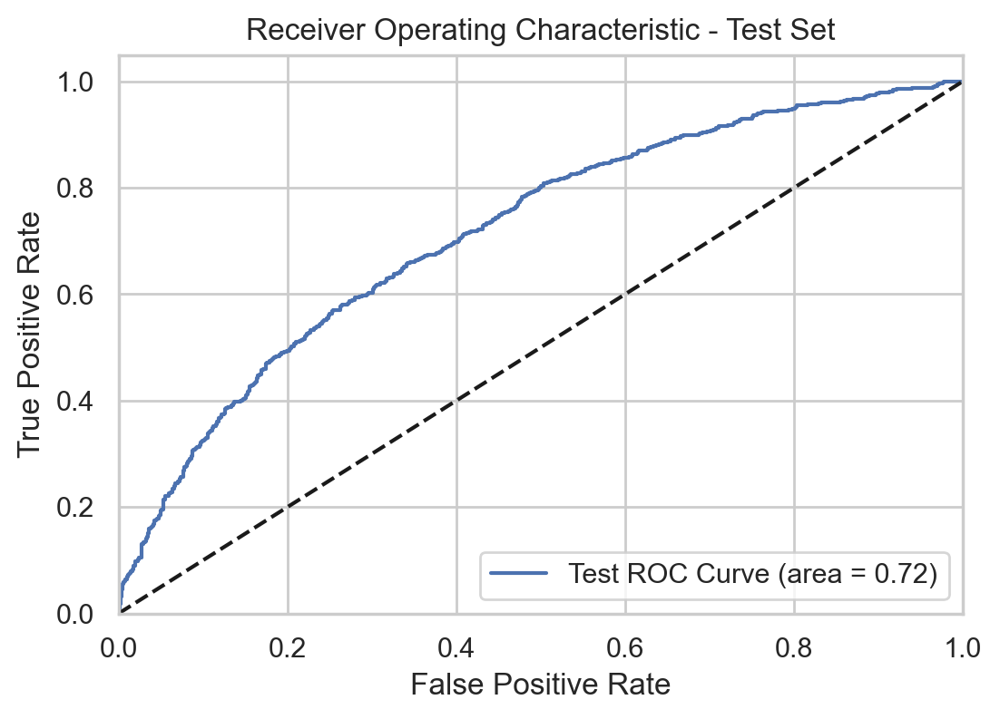


Proportion of CVD = 1 in the training data after SMOTE:
CVD
1    0.5
0    0.5
Name: proportion, dtype: float64


In [42]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np


# Separate features and target
X = fram2.drop('CVD', axis=1)
y = fram2['CVD']

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns=X.columns)

# Split data into train, validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X_scaled_df, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Train the logistic regression model on the SMOTE data
smote_logistic_regression_model = LogisticRegression(random_state=42)
smote_logistic_regression_model.fit(X_train_smote, y_train_smote)

# Validation set predictions
y_pred_val = smote_logistic_regression_model.predict(X_val)
y_pred_proba_val = smote_logistic_regression_model.predict_proba(X_val)[:, 1]

# Test set predictions
y_pred_test = smote_logistic_regression_model.predict(X_test)
y_pred_proba_test = smote_logistic_regression_model.predict_proba(X_test)[:, 1]

# Calculate and display odds ratios
coefficients = smote_logistic_regression_model.coef_[0]
odds_ratios = np.exp(coefficients)

# Display odds ratios
print("\nOdds Ratios for each feature:")
odds_ratio_df = pd.DataFrame({
    "Feature": X.columns,
    "Odds Ratio": odds_ratios
})
print(odds_ratio_df)

# Evaluation metrics for validation set
metrics_val = {
    "Accuracy": accuracy_score(y_val, y_pred_val),
    "Precision": precision_score(y_val, y_pred_val),
    "Recall": recall_score(y_val, y_pred_val),
    "F1 Score": f1_score(y_val, y_pred_val),
    "ROC AUC": roc_auc_score(y_val, y_pred_proba_val)
}

# Evaluation metrics for test set
metrics_test = {
    "Accuracy": accuracy_score(y_test, y_pred_test),
    "Precision": precision_score(y_test, y_pred_test),
    "Recall": recall_score(y_test, y_pred_test),
    "F1 Score": f1_score(y_test, y_pred_test),
    "ROC AUC": roc_auc_score(y_test, y_pred_proba_test)
}

# Print evaluation results
print("\nValidation Set Metrics:")
for key, value in metrics_val.items():
    print(f"{key}: {value:.4f}")

print("\nTest Set Metrics:")
for key, value in metrics_test.items():
    print(f"{key}: {value:.4f}")

# Plot ROC curve for the test set
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba_test)
plt.figure()
plt.plot(fpr, tpr, label=f'Test ROC Curve (area = {metrics_test["ROC AUC"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Test Set')
plt.legend(loc="lower right")
plt.show()

# Display proportion of CVD = 1 after applying SMOTE
print("\nProportion of CVD = 1 in the training data after SMOTE:")
print(y_train_smote.value_counts(normalize=True))


Optimization terminated successfully.
         Current function value: 0.601418
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:                    CVD   No. Observations:                 9484
Model:                          Logit   Df Residuals:                     9471
Method:                           MLE   Df Model:                           12
Date:                Fri, 20 Sep 2024   Pseudo R-squ.:                  0.1323
Time:                        22:34:30   Log-Likelihood:                -5703.9
converged:                       True   LL-Null:                       -6573.8
Covariance Type:            nonrobust   LLR p-value:                     0.000
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.1570      0.023     -6.774      0.000      -0.202      -0.112
SEX  

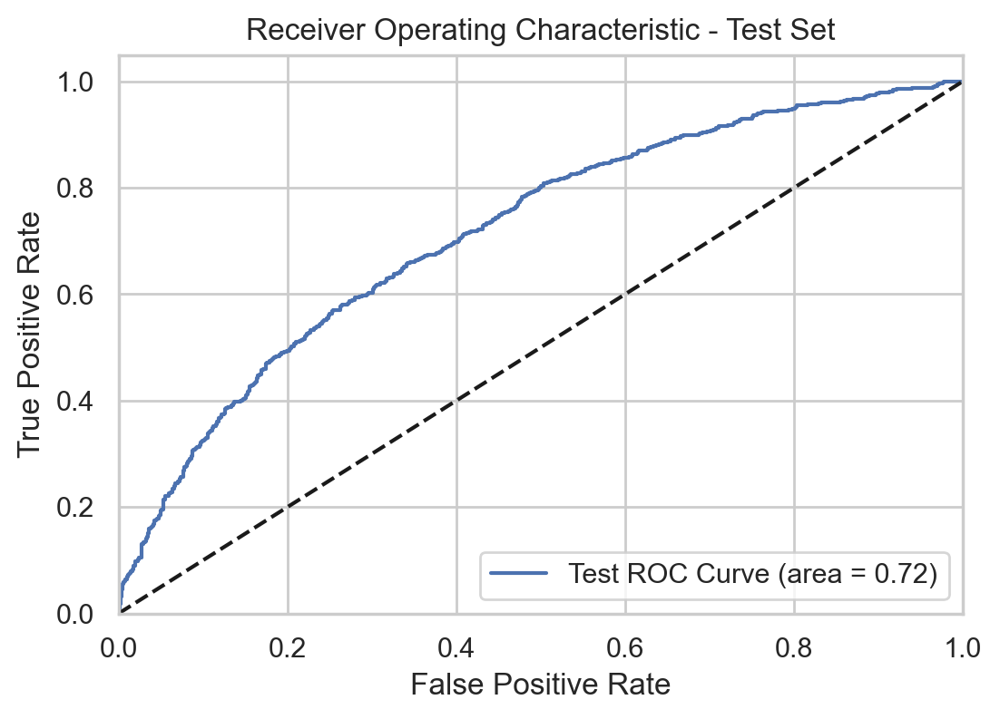


Proportion of CVD = 1 in the training data after SMOTE:
CVD
1    0.5
0    0.5
Name: proportion, dtype: float64


In [45]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import statsmodels.api as sm

# Separate features and target
X = fram2.drop('CVD', axis=1)
y = fram2['CVD']

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns=X.columns)

# Split data into train, validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X_scaled_df, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Train the logistic regression model on the SMOTE data
smote_logistic_regression_model = LogisticRegression(random_state=42)
smote_logistic_regression_model.fit(X_train_smote, y_train_smote)

# Add a constant to the data for statsmodels compatibility
X_train_smote_const = sm.add_constant(X_train_smote)

# Fit the logistic regression model using statsmodels for summary
smote_logit_model = sm.Logit(y_train_smote, X_train_smote_const)
result = smote_logit_model.fit()

# Display the model summary from statsmodels (includes coefficients, p-values, etc.)
print(result.summary())

# Extract odds ratios from the fitted coefficients
coefficients = smote_logistic_regression_model.coef_[0]
odds_ratios = np.exp(coefficients)

# Display odds ratios
print("\nOdds Ratios for each feature:")
odds_ratio_df = pd.DataFrame({
    "Feature": X.columns,
    "Odds Ratio": odds_ratios
})
print(odds_ratio_df)

# Evaluation metrics for validation set
metrics_val = {
    "Accuracy": accuracy_score(y_val, y_pred_val),
    "Precision": precision_score(y_val, y_pred_val),
    "Recall": recall_score(y_val, y_pred_val),
    "F1 Score": f1_score(y_val, y_pred_val),
    "ROC AUC": roc_auc_score(y_val, y_pred_proba_val)
}

# Evaluation metrics for test set
metrics_test = {
    "Accuracy": accuracy_score(y_test, y_pred_test),
    "Precision": precision_score(y_test, y_pred_test),
    "Recall": recall_score(y_test, y_pred_test),
    "F1 Score": f1_score(y_test, y_pred_test),
    "ROC AUC": roc_auc_score(y_test, y_pred_proba_test)
}

# Print evaluation results
print("\nValidation Set Metrics:")
for key, value in metrics_val.items():
    print(f"{key}: {value:.4f}")

print("\nTest Set Metrics:")
for key, value in metrics_test.items():
    print(f"{key}: {value:.4f}")

# Plot ROC curve for the test set
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba_test)
plt.figure()
plt.plot(fpr, tpr, label=f'Test ROC Curve (area = {metrics_test["ROC AUC"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Test Set')
plt.legend(loc="lower right")
plt.show()

# Display proportion of CVD = 1 after applying SMOTE
print("\nProportion of CVD = 1 in the training data after SMOTE:")
print(y_train_smote.value_counts(normalize=True))


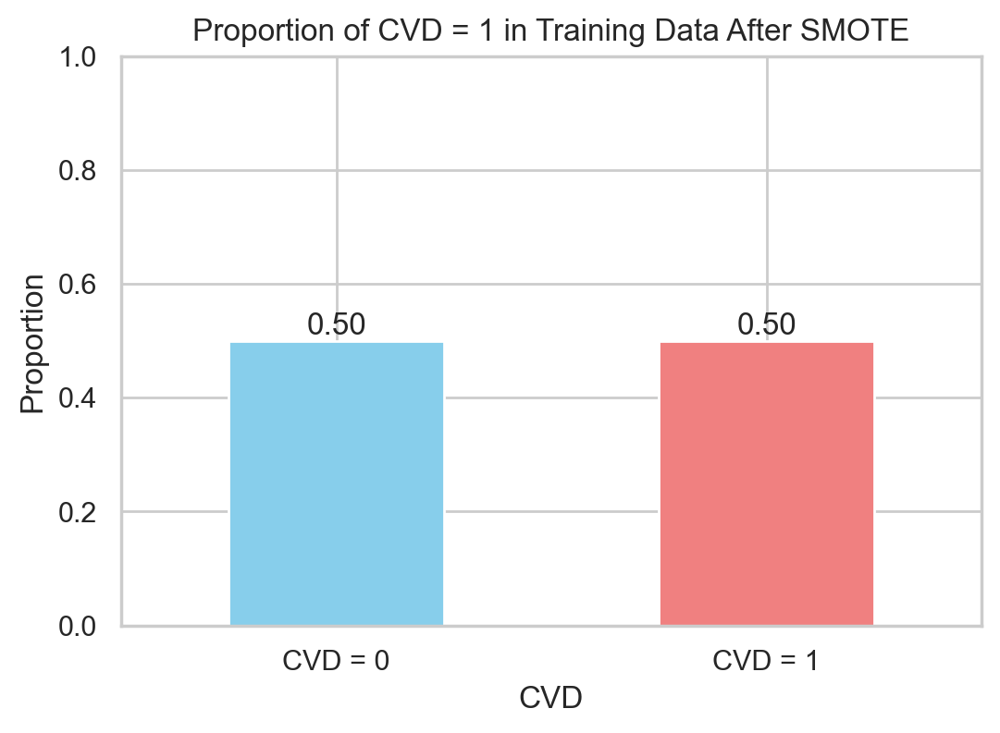

In [43]:
# Plot the proportion of CVD = 1 after applying SMOTE
proportion_smote = y_train_smote.value_counts(normalize=True)

plt.figure(figsize=(6, 4))
proportion_smote.plot(kind='bar', color=['skyblue', 'lightcoral'])
plt.title('Proportion of CVD = 1 in Training Data After SMOTE')
plt.xlabel('CVD')
plt.ylabel('Proportion')
plt.xticks([0, 1], labels=['CVD = 0', 'CVD = 1'], rotation=0)
plt.ylim(0, 1)
for i, val in enumerate(proportion_smote):
    plt.text(i, val, f'{val:.2f}', ha='center', va='bottom', fontsize=12)
plt.show()


## STEPWISE

In [121]:
import statsmodels.api as sm

def stepwise_selection(X, y, initial_list=[], threshold_in=0.005, threshold_out=0.01, verbose=True):
    included = list(initial_list)
    while True:
        changed = False
        # Forward step
        excluded = list(set(X.columns) - set(included))
        new_pval = pd.Series(index=excluded)
        for new_column in excluded:
            model = sm.Logit(y, sm.add_constant(pd.DataFrame(X[included + [new_column]]))).fit(disp=0)
            new_pval[new_column] = model.pvalues[new_column]
        best_pval = new_pval.min()
        if best_pval < threshold_in:
            best_feature = new_pval.idxmin()
            included.append(best_feature)
            changed = True
            if verbose:
                print('Add  {:30} with p-value {:.6}'.format(best_feature, best_pval))

        # Backward step
        model = sm.Logit(y, sm.add_constant(pd.DataFrame(X[included]))).fit(disp=0)
        # use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max()  # null if pvalues is empty
        if worst_pval > threshold_out:
            changed=True
            worst_feature = pvalues.idxmax()
            included.remove(worst_feature)
            if verbose:
                print('Drop {:30} with p-value {:.6}'.format(worst_feature, worst_pval))

        if not changed:
            break

    return included

# Example usage
X = fram2.drop('CVD', axis=1)  # feature dataframe
y = fram2['CVD']               # target variable

selected_features = stepwise_selection(X, y)

print('Selected features:', selected_features)


Add  PREVIOUS_CVD_EVENT             with p-value 4.44661e-194
Add  SEX                            with p-value 8.42831e-59
Add  AGE                            with p-value 2.2108e-47
Add  DIABETES                       with p-value 1.93977e-26
Add  TOTCHOL                        with p-value 6.0305e-19
Add  BPMAP                          with p-value 4.08579e-10
Add  CURSMOKE                       with p-value 2.34428e-07
Add  BMI                            with p-value 2.19429e-08
Add  HEARTRTE                       with p-value 1.91628e-05
Add  HYPERTEN                       with p-value 5.15248e-05
Add  BPMEDS                         with p-value 0.00320076
Selected features: ['PREVIOUS_CVD_EVENT', 'SEX', 'AGE', 'DIABETES', 'TOTCHOL', 'BPMAP', 'CURSMOKE', 'BMI', 'HEARTRTE', 'HYPERTEN', 'BPMEDS']


Add  PREVIOUS_CVD_EVENT             with p-value 4.44661e-194
Add  SEX                            with p-value 8.42831e-59
Add  AGE                            with p-value 2.2108e-47
Add  DIABETES                       with p-value 1.93977e-26
Add  TOTCHOL                        with p-value 6.0305e-19
Add  BPMAP                          with p-value 4.08579e-10
Add  CURSMOKE                       with p-value 2.34428e-07
Add  BMI                            with p-value 2.19429e-08
Add  HEARTRTE                       with p-value 1.91628e-05
Add  HYPERTEN                       with p-value 5.15248e-05
Add  BPMEDS                         with p-value 0.00320076
Selected features: ['PREVIOUS_CVD_EVENT', 'SEX', 'AGE', 'DIABETES', 'TOTCHOL', 'BPMAP', 'CURSMOKE', 'BMI', 'HEARTRTE', 'HYPERTEN', 'BPMEDS']
Optimization terminated successfully.
         Current function value: 0.549015
         Iterations 6
                           Logit Regression Results                           
Dep. Vari

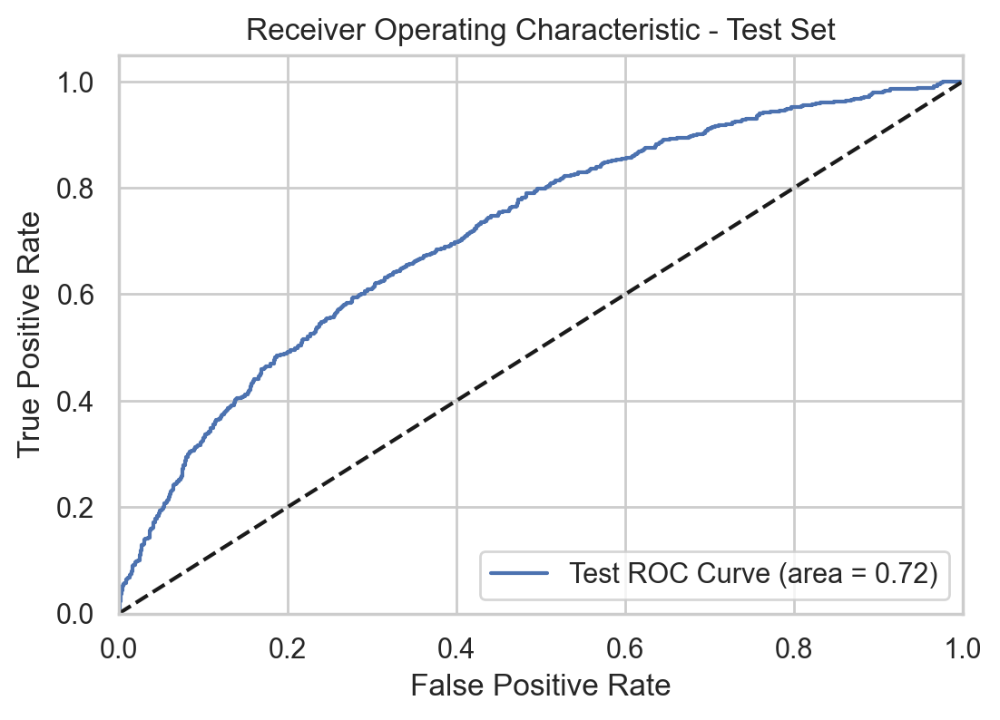

In [123]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt

# Selected features from stepwise regression process
selected_features = stepwise_selection(X, y)

print('Selected features:', selected_features)

# Define the dataset using selected features
X = fram2[selected_features]
y = fram2['CVD']

# Split the data into train, validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2

# Add a constant (intercept) to the features
X_train_const = sm.add_constant(X_train)
X_val_const = sm.add_constant(X_val)
X_test_const = sm.add_constant(X_test)

# Fit a logistic regression model using MLE (Maximum Likelihood Estimation)
logit_model = sm.Logit(y_train, X_train_const).fit(method='newton')  # Using Newton-Raphson method for MLE

# Print the model summary
print(logit_model.summary())

# Calculate odds ratios with 95% confidence intervals
odds_ratios = np.exp(logit_model.params)
conf = logit_model.conf_int()
conf['OR'] = odds_ratios
conf.columns = ['2.5%', '97.5%', 'Odds Ratio']
print("Odds Ratios with Confidence Intervals:")
print(conf)

# Evaluate the model on the validation set
y_pred_proba_val = logit_model.predict(X_val_const)
y_pred_val = (y_pred_proba_val >= 0.5).astype(int)

# Evaluation metrics for validation set
val_accuracy = accuracy_score(y_val, y_pred_val)
val_precision = precision_score(y_val, y_pred_val)
val_recall = recall_score(y_val, y_pred_val)
val_f1 = f1_score(y_val, y_pred_val)
val_roc_auc = roc_auc_score(y_val, y_pred_proba_val)

# Evaluate the model on the test set
y_pred_proba_test = logit_model.predict(X_test_const)
y_pred_test = (y_pred_proba_test >= 0.5).astype(int)

# Evaluation metrics for test set
test_accuracy = accuracy_score(y_test, y_pred_test)
test_precision = precision_score(y_test, y_pred_test)
test_recall = recall_score(y_test, y_pred_test)
test_f1 = f1_score(y_test, y_pred_test)
test_roc_auc = roc_auc_score(y_test, y_pred_proba_test)

# Print evaluation metrics
print("Validation Set Metrics:")
print(f"Accuracy: {val_accuracy:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, F1 Score: {val_f1:.4f}, ROC AUC: {val_roc_auc:.4f}")
print("Test Set Metrics:")
print(f"Accuracy: {test_accuracy:.4f}, Precision: {test_precision:.4f}, Recall: {test_recall:.4f}, F1 Score: {test_f1:.4f}, ROC AUC: {test_roc_auc:.4f}")

# Plot ROC curve for test set
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba_test)
plt.figure()
plt.plot(fpr, tpr, label=f'Test ROC Curve (area = {test_roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Test Set')
plt.legend(loc="lower right")
plt.show()


## SMOTE +STEPWISE

Optimization terminated successfully.
         Current function value: 0.633928
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:                    CVD   No. Observations:                 9484
Model:                          Logit   Df Residuals:                     9472
Method:                           MLE   Df Model:                           11
Date:                Tue, 03 Sep 2024   Pseudo R-squ.:                 0.08543
Time:                        00:22:29   Log-Likelihood:                -6012.2
converged:                       True   LL-Null:                       -6573.8
Covariance Type:            nonrobust   LLR p-value:                5.534e-234
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -5.4398      0.314    -17.348      0.000      -6.054      -4.825
PREVI

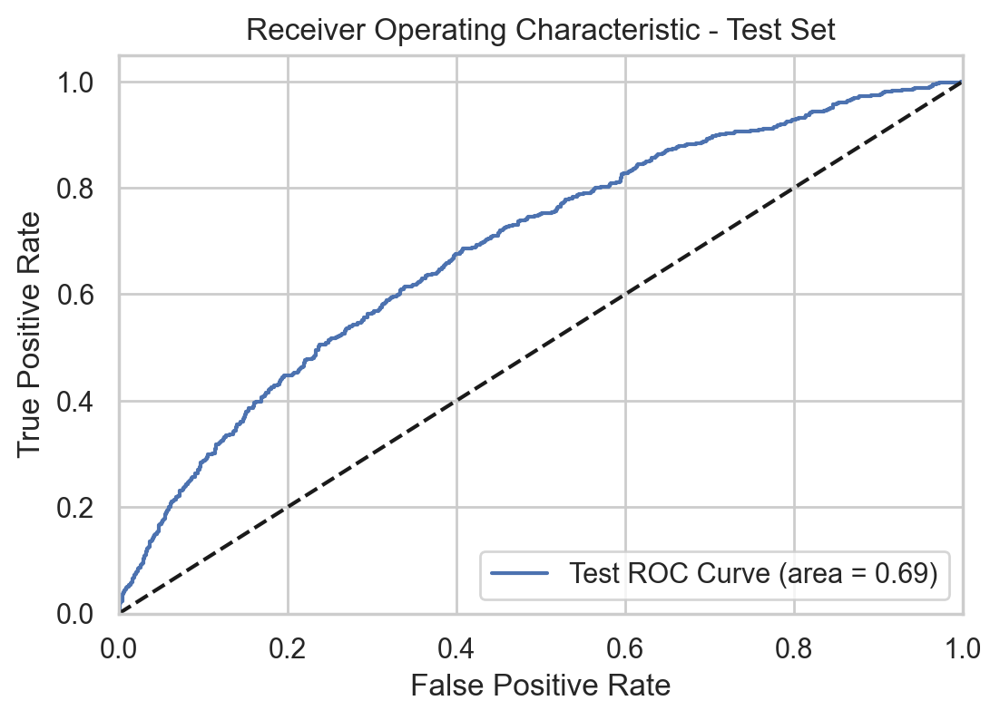

In [127]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt

# Selected features from stepwise regression
selected_features = ['PREVIOUS_CVD_EVENT', 'SEX', 'AGE', 'DIABETES', 'TOTCHOL', 'BPMAP', 'CURSMOKE', 'BMI', 'HEARTRTE', 'HYPERTEN', 'BPMEDS']
X = fram2[selected_features]
y = fram2['CVD']

# Split the data into train, validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Fit a Logit model using MLE on the SMOTE data
X_train_const_smote = sm.add_constant(X_train_smote)  # Adding a constant for intercept
logit_model = sm.Logit(y_train_smote, X_train_const_smote).fit(method='newton')  # Use MLE method

# Print the Logit summary
print(logit_model.summary())

# Calculate odds ratios with 95% confidence intervals
odds_ratios = np.exp(logit_model.params)
conf = logit_model.conf_int()
conf['OR'] = odds_ratios
conf.columns = ['2.5%', '97.5%', 'Odds Ratio']
print("Odds Ratios with Confidence Intervals:")
print(conf)

# Evaluate the model on the validation set
X_val_const = sm.add_constant(X_val)
y_pred_proba_val = logit_model.predict(X_val_const)
y_pred_val = (y_pred_proba_val >= 0.5).astype(int)

# Evaluation metrics for validation set
val_accuracy = accuracy_score(y_val, y_pred_val)
val_precision = precision_score(y_val, y_pred_val)
val_recall = recall_score(y_val, y_pred_val)
val_f1 = f1_score(y_val, y_pred_val)
val_roc_auc = roc_auc_score(y_val, y_pred_proba_val)

# Evaluate the model on the test set
X_test_const = sm.add_constant(X_test)
y_pred_proba_test = logit_model.predict(X_test_const)
y_pred_test = (y_pred_proba_test >= 0.5).astype(int)

# Evaluation metrics for test set
test_accuracy = accuracy_score(y_test, y_pred_test)
test_precision = precision_score(y_test, y_pred_test)
test_recall = recall_score(y_test, y_pred_test)
test_f1 = f1_score(y_test, y_pred_test)
test_roc_auc = roc_auc_score(y_test, y_pred_proba_test)

# Print evaluation metrics
print("Validation Set Metrics:")
print(f"Accuracy: {val_accuracy:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, F1 Score: {val_f1:.4f}, ROC AUC: {val_roc_auc:.4f}")
print("Test Set Metrics:")
print(f"Accuracy: {test_accuracy:.4f}, Precision: {test_precision:.4f}, Recall: {test_recall:.4f}, F1 Score: {test_f1:.4f}, ROC AUC: {test_roc_auc:.4f}")

# Plot ROC curve for test set
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba_test)
plt.figure()
plt.plot(fpr, tpr, label=f'Test ROC Curve (area = {test_roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Test Set')
plt.legend(loc="lower right")
plt.show()


In [136]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd


# Define the features and target
features = ['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'PREVIOUS_CVD_EVENT', 'BPMAP']
target = 'CVD'

# Select features and target from the dataframe
X = fram2[features]
y = fram2[target]

# One-hot encoding for categorical variables
categorical_features = ['SEX', 'CURSMOKE', 'DIABETES', 'BPMEDS', 'HYPERTEN', 'PREVIOUS_CVD_EVENT']
X = pd.get_dummies(X, columns=categorical_features, drop_first=True)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split the data into train, validation, and test sets (60% train, 20% val, 20% test)
X_train, X_temp, y_train, y_temp = train_test_split(X_scaled, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define models
knn = KNeighborsClassifier(n_neighbors=5)
decision_tree = DecisionTreeClassifier(random_state=42)
random_forest = RandomForestClassifier(random_state=42)
logistic_regression = LogisticRegression(random_state=42, max_iter=1000)

# Ensemble model using voting
ensemble = VotingClassifier(estimators=[
    ('knn', knn),
    ('dt', decision_tree),
    ('rf', random_forest),
    ('lr', logistic_regression)
], voting='soft')

# List of models to evaluate
models = {
    'KNN': knn,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'Ensemble': ensemble
}

# Dictionary to store evaluation metrics
evaluation_results = {}

# Fit and evaluate each model
for model_name, model in models.items():
    model.fit(X_train, y_train)
    
    # Validation set predictions
    y_pred_val = model.predict(X_val)
    y_pred_proba_val = model.predict_proba(X_val)[:, 1]
    
    # Test set predictions
    y_pred_test = model.predict(X_test)
    y_pred_proba_test = model.predict_proba(X_test)[:, 1]
    
    # Evaluation metrics for validation set
    metrics_val = {
        "Accuracy": accuracy_score(y_val, y_pred_val),
        "Precision": precision_score(y_val, y_pred_val),
        "Recall": recall_score(y_val, y_pred_val),
        "F1 Score": f1_score(y_val, y_pred_val),
        "ROC AUC": roc_auc_score(y_val, y_pred_proba_val)
    }
    
    # Evaluation metrics for test set
    metrics_test = {
        "Accuracy": accuracy_score(y_test, y_pred_test),
        "Precision": precision_score(y_test, y_pred_test),
        "Recall": recall_score(y_test, y_pred_test),
        "F1 Score": f1_score(y_test, y_pred_test),
        "ROC AUC": roc_auc_score(y_test, y_pred_proba_test)
    }
    
    evaluation_results[model_name] = {
        'Validation': metrics_val,
        'Test': metrics_test
    }

# Print evaluation results
for model_name, metrics in evaluation_results.items():
    print(f"\nModel: {model_name}")
    print("Validation Set Metrics:")
    for key, value in metrics['Validation'].items():
        print(f"{key}: {value:.4f}")
    print("Test Set Metrics:")
    for key, value in metrics['Test'].items():
        print(f"{key}: {value:.4f}")



Model: KNN
Validation Set Metrics:
Accuracy: 0.6856
Precision: 0.5514
Recall: 0.4071
F1 Score: 0.4684
ROC AUC: 0.6774
Test Set Metrics:
Accuracy: 0.6879
Precision: 0.4982
Recall: 0.3923
F1 Score: 0.4389
ROC AUC: 0.6634

Model: Decision Tree
Validation Set Metrics:
Accuracy: 0.6366
Precision: 0.4652
Recall: 0.4564
F1 Score: 0.4608
ROC AUC: 0.5929
Test Set Metrics:
Accuracy: 0.6221
Precision: 0.3957
Recall: 0.4061
F1 Score: 0.4008
ROC AUC: 0.5629

Model: Random Forest
Validation Set Metrics:
Accuracy: 0.7019
Precision: 0.5992
Recall: 0.3742
F1 Score: 0.4607
ROC AUC: 0.7203
Test Set Metrics:
Accuracy: 0.7034
Precision: 0.5351
Recall: 0.3577
F1 Score: 0.4288
ROC AUC: 0.7062

Model: Ensemble
Validation Set Metrics:
Accuracy: 0.6929
Precision: 0.5677
Recall: 0.4083
F1 Score: 0.4750
ROC AUC: 0.7113
Test Set Metrics:
Accuracy: 0.6814
Precision: 0.4850
Recall: 0.3785
F1 Score: 0.4251
ROC AUC: 0.6862


In [153]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd


# Define the features and target
features = ['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS', 'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'PREVIOUS_CVD_EVENT', 'BPMAP']
target = 'CVD'

# Select features and target from the dataframe
X = fram2[features]
y = fram2[target]

# One-hot encoding for categorical variables
categorical_features = ['SEX', 'CURSMOKE', 'DIABETES', 'BPMEDS', 'HYPERTEN', 'PREVIOUS_CVD_EVENT']
X = pd.get_dummies(X, columns=categorical_features, drop_first=True)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split the data into train, validation, and test sets (60% train, 20% val, 20% test)
X_train, X_temp, y_train, y_temp = train_test_split(X_scaled, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define models
knn = KNeighborsClassifier(n_neighbors=5)
decision_tree = DecisionTreeClassifier(random_state=42)
random_forest = RandomForestClassifier(random_state=42)
logistic_regression = LogisticRegression(random_state=42, max_iter=1000)

# Ensemble model using voting
ensemble = VotingClassifier(estimators=[
    ('knn', knn),
    ('dt', decision_tree),
    ('rf', random_forest),
    ('lr', logistic_regression)
], voting='soft')

# List of models to evaluate
models = {
    'KNN': knn,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'Logistic Regression': logistic_regression,  # Added Logistic Regression as a standalone model
   # 'Ensemble': ensemble
}

# Dictionary to store evaluation metrics
evaluation_results = {}

# Fit and evaluate each model
for model_name, model in models.items():
    model.fit(X_train, y_train)
    
    # Validation set predictions
    y_pred_val = model.predict(X_val)
    y_pred_proba_val = model.predict_proba(X_val)[:, 1]
    
    # Test set predictions
    y_pred_test = model.predict(X_test)
    y_pred_proba_test = model.predict_proba(X_test)[:, 1]
    
    # Evaluation metrics for validation set
    metrics_val = {
        "Accuracy": accuracy_score(y_val, y_pred_val),
        "Precision": precision_score(y_val, y_pred_val),
        "Recall": recall_score(y_val, y_pred_val),
        "F1 Score": f1_score(y_val, y_pred_val),
        "ROC AUC": roc_auc_score(y_val, y_pred_proba_val)
    }
    
    # Evaluation metrics for test set
    metrics_test = {
        "Accuracy": accuracy_score(y_test, y_pred_test),
        "Precision": precision_score(y_test, y_pred_test),
        "Recall": recall_score(y_test, y_pred_test),
        "F1 Score": f1_score(y_test, y_pred_test),
        "ROC AUC": roc_auc_score(y_test, y_pred_proba_test)
    }
    
    evaluation_results[model_name] = {
        'Validation': metrics_val,
        'Test': metrics_test
    }

# Print evaluation results
for model_name, metrics in evaluation_results.items():
    print(f"\nModel: {model_name}")
    print("Validation Set Metrics:")
    for key, value in metrics['Validation'].items():
        print(f"{key}: {value:.4f}")
    print("Test Set Metrics:")
    for key, value in metrics['Test'].items():
        print(f"{key}: {value:.4f}")



Model: KNN
Validation Set Metrics:
Accuracy: 0.6856
Precision: 0.5514
Recall: 0.4071
F1 Score: 0.4684
ROC AUC: 0.6774
Test Set Metrics:
Accuracy: 0.6879
Precision: 0.4982
Recall: 0.3923
F1 Score: 0.4389
ROC AUC: 0.6634

Model: Decision Tree
Validation Set Metrics:
Accuracy: 0.6366
Precision: 0.4652
Recall: 0.4564
F1 Score: 0.4608
ROC AUC: 0.5929
Test Set Metrics:
Accuracy: 0.6221
Precision: 0.3957
Recall: 0.4061
F1 Score: 0.4008
ROC AUC: 0.5629

Model: Random Forest
Validation Set Metrics:
Accuracy: 0.7019
Precision: 0.5992
Recall: 0.3742
F1 Score: 0.4607
ROC AUC: 0.7203
Test Set Metrics:
Accuracy: 0.7034
Precision: 0.5351
Recall: 0.3577
F1 Score: 0.4288
ROC AUC: 0.7062

Model: Logistic Regression
Validation Set Metrics:
Accuracy: 0.7118
Precision: 0.6360
Recall: 0.3578
F1 Score: 0.4579
ROC AUC: 0.7303
Test Set Metrics:
Accuracy: 0.7089
Precision: 0.5548
Recall: 0.3287
F1 Score: 0.4128
ROC AUC: 0.7126


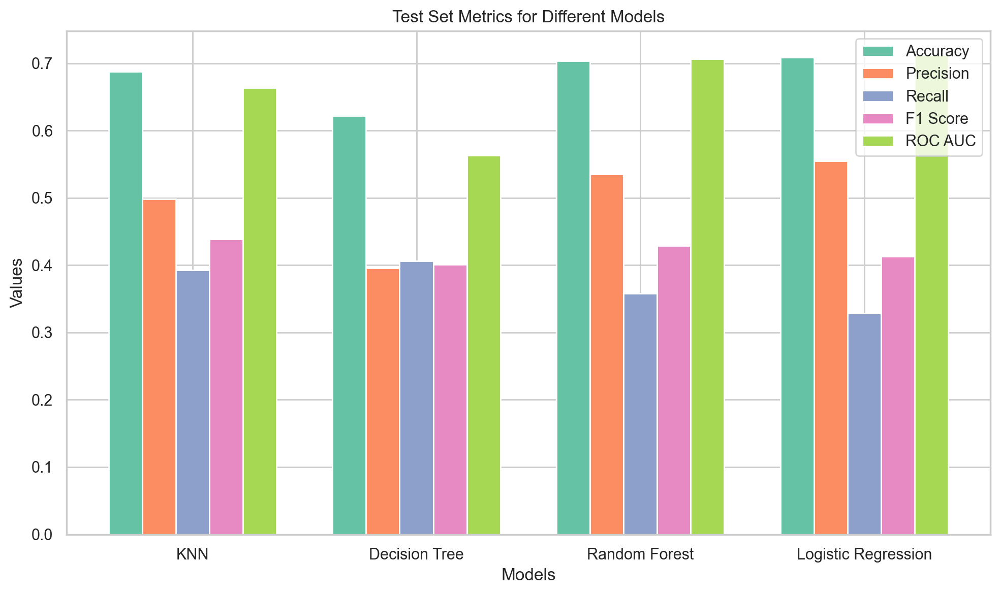

In [157]:
import matplotlib.pyplot as plt
import numpy as np

# Test set metrics
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC']
models = ['KNN', 'Decision Tree', 'Random Forest', 'Logistic Regression']

# Corresponding test set metrics for each model
knn_metrics = [0.6879, 0.4982, 0.3923, 0.4389, 0.6634]
decision_tree_metrics = [0.6221, 0.3957, 0.4061, 0.4008, 0.5629]
random_forest_metrics = [0.7034, 0.5351, 0.3577, 0.4288, 0.7062]
logistic_regression_metrics = [0.7089, 0.5548, 0.3287, 0.4128, 0.7126]

# Set the position of the bars on the x-axis
x = np.arange(len(models))

# Set colors for the metrics
colors = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854']

# Create subplots
fig, ax = plt.subplots(figsize=(10, 6))

# Width of the bars
bar_width = 0.15

# Plot the bars for each metric
ax.bar(x - bar_width * 2, [m[0] for m in [knn_metrics, decision_tree_metrics, random_forest_metrics, logistic_regression_metrics]], bar_width, label='Accuracy', color=colors[0])
ax.bar(x - bar_width, [m[1] for m in [knn_metrics, decision_tree_metrics, random_forest_metrics, logistic_regression_metrics]], bar_width, label='Precision', color=colors[1])
ax.bar(x, [m[2] for m in [knn_metrics, decision_tree_metrics, random_forest_metrics, logistic_regression_metrics]], bar_width, label='Recall', color=colors[2])
ax.bar(x + bar_width, [m[3] for m in [knn_metrics, decision_tree_metrics, random_forest_metrics, logistic_regression_metrics]], bar_width, label='F1 Score', color=colors[3])
ax.bar(x + bar_width * 2, [m[4] for m in [knn_metrics, decision_tree_metrics, random_forest_metrics, logistic_regression_metrics]], bar_width, label='ROC AUC', color=colors[4])

# Add labels, title, and legend
ax.set_xlabel('Models')
ax.set_ylabel('Values')
ax.set_title('Test Set Metrics for Different Models')
ax.set_xticks(x)
ax.set_xticklabels(models)
ax.legend()

# Show the chart
plt.tight_layout()
plt.show()


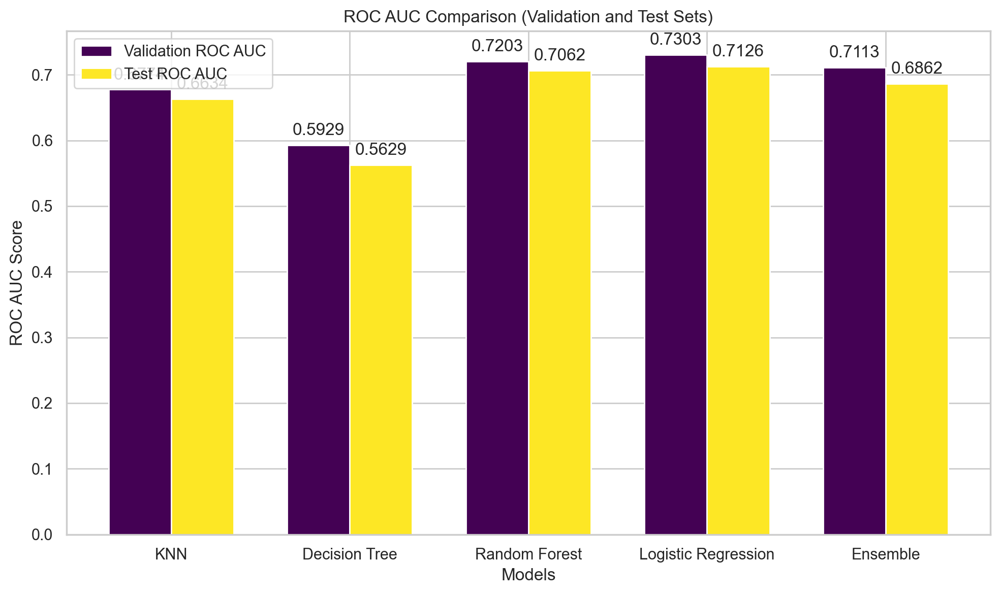

In [144]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm

# Data for ROC AUC (Validation and Test Set)
models = ['KNN', 'Decision Tree', 'Random Forest', 'Logistic Regression', 'Ensemble']
val_roc_auc = [0.6774, 0.5929, 0.7203, 0.7303, 0.7113]
test_roc_auc = [0.6634, 0.5629, 0.7062, 0.7126, 0.6862]

# Viridis color palette
viridis = cm.get_cmap('viridis', 2)

# Plotting setup for ROC AUC
fig, ax = plt.subplots(figsize=(10, 6))
index = np.arange(len(models))
bar_width = 0.35

# Plot bars for ROC AUC for validation and test sets
bars_val_roc = ax.bar(index, val_roc_auc, bar_width, color=viridis(0), label='Validation ROC AUC')
bars_test_roc = ax.bar(index + bar_width, test_roc_auc, bar_width, color=viridis(1), label='Test ROC AUC')

# Adding labels and title
ax.set_xlabel('Models')
ax.set_ylabel('ROC AUC Score')
ax.set_title('ROC AUC Comparison (Validation and Test Sets)')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(models)
ax.legend()

# Adding the score on top of the bars
def add_labels(bars):
    for bar in bars:
        yval = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, yval + 0.01, f'{yval:.4f}', ha='center', va='bottom')

add_labels(bars_val_roc)
add_labels(bars_test_roc)

plt.tight_layout()
plt.show()


In [131]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from imblearn.over_sampling import SMOTE

# Assuming your data is in a DataFrame called 'fram2'
# Define features and target
features = ['SEX', 'TOTCHOL', 'AGE', 'CURSMOKE', 'BMI', 'DIABETES', 'BPMEDS',
            'HEARTRTE', 'GLUCOSE', 'HYPERTEN', 'PREVIOUS_CVD_EVENT', 'BPMAP']
target = 'CVD'

X = fram2[features]
y = fram2[target]

# Categorical and continuous features
categorical_features = ['SEX', 'CURSMOKE', 'DIABETES', 'BPMEDS', 'HYPERTEN', 'PREVIOUS_CVD_EVENT']
continuous_features = ['TOTCHOL', 'AGE', 'BMI', 'HEARTRTE', 'GLUCOSE', 'BPMAP']

# Column transformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), categorical_features),
        ('num', StandardScaler(), continuous_features)
    ]
)

# Apply preprocessing to the features
X_processed = preprocessor.fit_transform(X)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_processed, y, test_size=0.2, random_state=42)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Dictionary to store the evaluation metrics for each model after SMOTE
results_smote = {}

# 1. K-Nearest Neighbors with SMOTE
knn_smote = KNeighborsClassifier(n_neighbors=5)
knn_smote.fit(X_train_smote, y_train_smote)
y_pred_knn_smote = knn_smote.predict(X_test)
y_pred_proba_knn_smote = knn_smote.predict_proba(X_test)[:, 1]
results_smote['KNN'] = {
    'Accuracy': accuracy_score(y_test, y_pred_knn_smote),
    'Precision': precision_score(y_test, y_pred_knn_smote),
    'Recall': recall_score(y_test, y_pred_knn_smote),
    'F1 Score': f1_score(y_test, y_pred_knn_smote),
    'ROC AUC': roc_auc_score(y_test, y_pred_proba_knn_smote)
}

# 2. Support Vector Machine with SMOTE
svm_smote = SVC(probability=True, random_state=42)
svm_smote.fit(X_train_smote, y_train_smote)
y_pred_svm_smote = svm_smote.predict(X_test)
y_pred_proba_svm_smote = svm_smote.predict_proba(X_test)[:, 1]
results_smote['SVM'] = {
    'Accuracy': accuracy_score(y_test, y_pred_svm_smote),
    'Precision': precision_score(y_test, y_pred_svm_smote),
    'Recall': recall_score(y_test, y_pred_svm_smote),
    'F1 Score': f1_score(y_test, y_pred_svm_smote),
    'ROC AUC': roc_auc_score(y_test, y_pred_proba_svm_smote)
}

# 3. Neural Networks with SMOTE
nn_smote = MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
nn_smote.fit(X_train_smote, y_train_smote)
y_pred_nn_smote = nn_smote.predict(X_test)
y_pred_proba_nn_smote = nn_smote.predict_proba(X_test)[:, 1]
results_smote['Neural Network'] = {
    'Accuracy': accuracy_score(y_test, y_pred_nn_smote),
    'Precision': precision_score(y_test, y_pred_nn_smote),
    'Recall': recall_score(y_test, y_pred_nn_smote),
    'F1 Score': f1_score(y_test, y_pred_nn_smote),
    'ROC AUC': roc_auc_score(y_test, y_pred_proba_nn_smote)
}

# 4. Random Forest with SMOTE
rf_smote = RandomForestClassifier(n_estimators=100, random_state=42)
rf_smote.fit(X_train_smote, y_train_smote)
y_pred_rf_smote = rf_smote.predict(X_test)
y_pred_proba_rf_smote = rf_smote.predict_proba(X_test)[:, 1]
results_smote['Random Forest'] = {
    'Accuracy': accuracy_score(y_test, y_pred_rf_smote),
    'Precision': precision_score(y_test, y_pred_rf_smote),
    'Recall': recall_score(y_test, y_pred_rf_smote),
    'F1 Score': f1_score(y_test, y_pred_rf_smote),
    'ROC AUC': roc_auc_score(y_test, y_pred_proba_rf_smote)
}

# 5. Decision Tree with SMOTE
dt_smote = DecisionTreeClassifier(random_state=42)
dt_smote.fit(X_train_smote, y_train_smote)
y_pred_dt_smote = dt_smote.predict(X_test)
y_pred_proba_dt_smote = dt_smote.predict_proba(X_test)[:, 1]
results_smote['Decision Tree'] = {
    'Accuracy': accuracy_score(y_test, y_pred_dt_smote),
    'Precision': precision_score(y_test, y_pred_dt_smote),
    'Recall': recall_score(y_test, y_pred_dt_smote),
    'F1 Score': f1_score(y_test, y_pred_dt_smote),
    'ROC AUC': roc_auc_score(y_test, y_pred_proba_dt_smote)
}

# 6. Ensemble (Voting Classifier) with SMOTE
ensemble_smote = VotingClassifier(estimators=[
    ('knn', knn_smote),
    ('svm', svm_smote),
    ('nn', nn_smote),
    ('rf', rf_smote),
    ('dt', dt_smote)
], voting='soft')
ensemble_smote.fit(X_train_smote, y_train_smote)
y_pred_ensemble_smote = ensemble_smote.predict(X_test)
y_pred_proba_ensemble_smote = ensemble_smote.predict_proba(X_test)[:, 1]
results_smote['Ensemble'] = {
    'Accuracy': accuracy_score(y_test, y_pred_ensemble_smote),
    'Precision': precision_score(y_test, y_pred_ensemble_smote),
    'Recall': recall_score(y_test, y_pred_ensemble_smote),
    'F1 Score': f1_score(y_test, y_pred_ensemble_smote),
    'ROC AUC': roc_auc_score(y_test, y_pred_proba_ensemble_smote)
}

# Print evaluation metrics for each model after applying SMOTE
for model, metrics in results_smote.items():
    print(f"\n{model} Model Metrics with SMOTE:")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.4f}")



KNN Model Metrics with SMOTE:
Accuracy: 0.6161
Precision: 0.4308
Recall: 0.5933
F1 Score: 0.4992
ROC AUC: 0.6436

SVM Model Metrics with SMOTE:
Accuracy: 0.6685
Precision: 0.4899
Recall: 0.6773
F1 Score: 0.5686
ROC AUC: 0.7085

Neural Network Model Metrics with SMOTE:
Accuracy: 0.6535
Precision: 0.4711
Recall: 0.6093
F1 Score: 0.5314
ROC AUC: 0.6964

Random Forest Model Metrics with SMOTE:
Accuracy: 0.6896
Precision: 0.5178
Recall: 0.5427
F1 Score: 0.5299
ROC AUC: 0.7175

Decision Tree Model Metrics with SMOTE:
Accuracy: 0.6079
Precision: 0.4096
Recall: 0.4893
F1 Score: 0.4459
ROC AUC: 0.5768

Ensemble Model Metrics with SMOTE:
Accuracy: 0.6681
Precision: 0.4879
Recall: 0.5893
F1 Score: 0.5338
ROC AUC: 0.6996


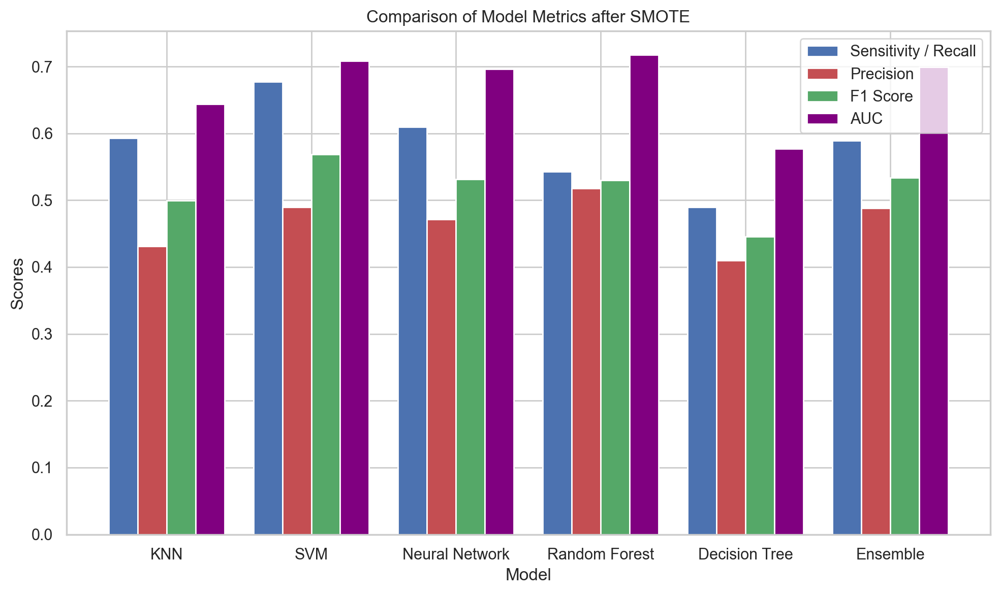

In [133]:
import matplotlib.pyplot as plt
import numpy as np

# Metrics from your results after applying SMOTE
model_names = ['KNN', 'SVM', 'Neural Network', 'Random Forest', 'Decision Tree', 'Ensemble']
sensitivity_recall = [0.5933, 0.6773, 0.6093, 0.5427, 0.4893, 0.5893]
precision = [0.4308, 0.4899, 0.4711, 0.5178, 0.4096, 0.4879]
f1_score = [0.4992, 0.5686, 0.5314, 0.5299, 0.4459, 0.5338]
roc_auc = [0.6436, 0.7085, 0.6964, 0.7175, 0.5768, 0.6996]

# Plotting
bar_width = 0.2
index = np.arange(len(model_names))

fig, ax = plt.subplots(figsize=(10, 6))

# Create bars for each metric
rects1 = ax.bar(index - 1.5 * bar_width, sensitivity_recall, bar_width, label='Sensitivity / Recall', color='b')
rects2 = ax.bar(index - 0.5 * bar_width, precision, bar_width, label='Precision', color='r')
rects3 = ax.bar(index + 0.5 * bar_width, f1_score, bar_width, label='F1 Score', color='g')
rects4 = ax.bar(index + 1.5 * bar_width, roc_auc, bar_width, label='AUC', color='purple')

# Adding labels and title
ax.set_xlabel('Model')
ax.set_ylabel('Scores')
ax.set_title('Comparison of Model Metrics after SMOTE')
ax.set_xticks(index)
ax.set_xticklabels(model_names)
ax.legend()

# Display the plot
plt.tight_layout()
plt.show()


## MODEL DEPLOYMENT

In [254]:
import joblib

# Save the smote trained logistic regression model
joblib.dump(smote_logistic_regression_model, 'smote_logistic_regression_model_v1.pkl')

# Save the scaler
joblib.dump(scaler, 'scaler.pkl')

print("Model and scaler saved successfully!")


Model and scaler saved successfully!


In [81]:
fram2.sample(12)

,SEX,TOTCHOL,AGE,CURSMOKE,BMI,DIABETES,BPMEDS,HEARTRTE,GLUCOSE,HYPERTEN,CVD,PREVIOUS_CVD_EVENT,BPMAP
5099,0,290.0,68,0,27.01,0,0.0,97.0,76.000000,1,0,1,110.000000
7534,1,238.0,45,1,31.14,0,1.0,78.0,70.000000,1,0,1,134.333333
7962,1,385.0,58,0,31.02,0,0.0,85.0,69.000000,0,1,0,92.333333
1982,1,208.0,55,0,30.36,0,1.0,85.0,93.000000,1,1,1,107.500000
10461,0,235.0,41,1,23.71,0,0.0,102.0,81.000000,1,0,0,105.666667
10124,1,240.0,43,1,25.60,0,0.0,65.0,113.000000,1,0,0,107.833333
7681,0,188.0,44,1,23.13,0,0.0,94.0,85.000000,1,0,0,85.833333
8139,1,303.0,42,0,27.13,0,0.0,75.0,69.000000,0,0,0,98.000000
7329,0,248.0,45,0,25.18,0,0.0,75.0,84.124865,0,0,0,93.333333
8692,1,267.0,58,0,29.63,0,0.0,66.0,84.000000,0,1,0,92.666667
